<a href="https://colab.research.google.com/github/Kim-matthew-0422/GAN-style/blob/main/GAN1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-0555f114-167d-edfb-c17c-ee1d798e40a9)


In [ ]:
from google.colab import files

In [ ]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"etkim422","key":"b91c86a0e76a000e4ddfd6ab1ceaf138"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [ ]:
!kaggle datasets download -d ikarus777/best-artworks-of-all-time

100% 2.29G/2.29G [01:57<00:00, 22.8MB/s]
100% 2.29G/2.29G [01:57<00:00, 21.0MB/s]


In [ ]:
!unzip best-artworks-of-all-time.zip

Streaming output truncated to the last 5000 lines.
  inflating: resized/resized/Henri_Rousseau_61.jpg  
  inflating: resized/resized/Henri_Rousseau_62.jpg  
  inflating: resized/resized/Henri_Rousseau_63.jpg  
  inflating: resized/resized/Henri_Rousseau_64.jpg  
  inflating: resized/resized/Henri_Rousseau_65.jpg  
  inflating: resized/resized/Henri_Rousseau_66.jpg  
  inflating: resized/resized/Henri_Rousseau_67.jpg  
  inflating: resized/resized/Henri_Rousseau_68.jpg  
  inflating: resized/resized/Henri_Rousseau_69.jpg  
  inflating: resized/resized/Henri_Rousseau_7.jpg  
  inflating: resized/resized/Henri_Rousseau_70.jpg  
  inflating: resized/resized/Henri_Rousseau_8.jpg  
  inflating: resized/resized/Henri_Rousseau_9.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_1.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_10.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_11.jpg  
  inflating: resized/resized/Henri_de_Toulouse-Lautrec_12.jpg  
  inflat

Sample arts


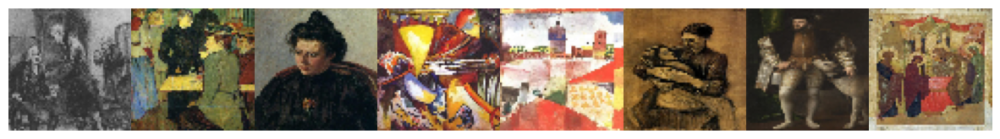

In [ ]:
import os
from glob import glob

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
import cv2 as cv

data_dir = ''
image_dir = 'resized/resized'
image_root = 'resized'
no_plots = 8*1
images = glob(f'{image_dir}/*')

plt.rcParams['figure.figsize'] = (15, 15)
plt.subplots_adjust(wspace=0, hspace=0)

print("Sample arts")
for idx,image in enumerate(images[:no_plots]):
    sample_img = cv.imread(image)
    sample_img = cv.resize(sample_img,(64,64))
    plt.subplot(1, 8, idx+1)
    plt.axis('off')
    plt.imshow(cv.cvtColor(sample_img,cv.COLOR_BGR2RGB))
plt.show()

In [ ]:
def tensor_imshow(img, dnorm=True):
  img = img.numpy()
  if dnorm:
    img = img*0.5+0.5
  plt.figure(figsize=(3, 3))
  plt.axis('off')
  plt.imshow(np.transpose(img, (1, 2, 0)))
  plt.show()

In [ ]:
import torch
from torchvision import datasets
from torchvision import transforms
def get_dataloader(batch_size,image_size,data_dir=image_dir,num_workers=3):
    stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
    transform = transforms.Compose([
        transforms.Resize((image_size,image_size)),
        transforms.ToTensor(),
        # We tranform our image values to be between -1 and 1 (the range of the tanh activation)
        transforms.Normalize(*stats), # 
    ])
    
    dataset = datasets.ImageFolder(root=data_dir,transform=transform)
    
    data_loader = torch.utils.data.DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=num_workers,
        pin_memory=True,
    )
    
    return data_loader

/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


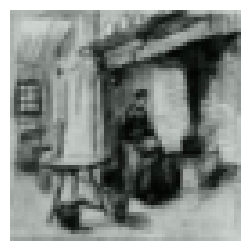

In [ ]:
# Testing the dataloader
batch_size, image_size = 5, 64
train_loader = get_dataloader(batch_size,image_size,image_root)
dataiter = iter(train_loader)

img,_ = next(dataiter)
sample_img = img[-1]
tensor_imshow(sample_img)

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

class Generator(nn.Module):
    def __init__(self,z_dim=10,in_chan=3,hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim
        
        self.generator = nn.Sequential(
            self.make_gen_block(z_dim,512,stride=1,padding=0,),
            self.make_gen_block(512,256),
            self.make_gen_block(256,128),
            self.make_gen_block(128,64),
            self.make_gen_block(64,32),
            self.make_gen_block(32, in_chan,final_layer=True),
        )
    
    def make_gen_block(self,in_channels,op_channels,kernel_size=4,stride=2,padding=1,final_layer=False):
        layers = []
        layers.append(nn.ConvTranspose2d(in_channels,op_channels,kernel_size,stride,padding,bias=False))
        
        if not final_layer:
            layers.append(nn.BatchNorm2d(op_channels))
            layers.append(nn.LeakyReLU(0.2))
        else:
            layers.append(nn.Tanh())
        
        return nn.Sequential(*layers)
    
    def forward(self,noise):
        x = noise.view(-1,self.z_dim,1,1)
        return self.generator(x)

    def get_noise(n_samples, z_dim, device='cpu'):
        return torch.randn(n_samples, z_dim, device=device)
class Discriminator(nn.Module):
    def __init__(self,im_chan=3,conv_dim=64,image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim
        
        self.disc_cnn = nn.Sequential(
            self.make_disc_block(3,32),
            self.make_disc_block(32,64),
            self.make_disc_block(64,128),
            self.make_disc_block(128,256),
            self.make_disc_block(256,512),
            self.make_disc_block(512,1,padding=0,final_layer=True),
        )
        
        
    def make_disc_block(self,in_chan,op_chan,kernel_size=4,stride=2,padding=1,final_layer=False):
        layers = []
        layers.append(nn.Conv2d(in_chan,op_chan,kernel_size,stride,padding,bias=False))
        
        if not final_layer:
            layers.append(nn.BatchNorm2d(op_chan))
            layers.append(nn.LeakyReLU(0.2, inplace=True))

             
        return nn.Sequential(*layers)
    
    
    def forward(self,image):
        pred = self.disc_cnn(image)
        pred = pred.view(image.size(0),-1)
        return pred
    
    def _get_final_feature_dimention(self):
        final_width_height = (self.image_size //  2**len(self.disc_cnn))**2
        final_depth = self.conv_dim * 2**(len(self.disc_cnn)-1)
        return final_depth*final_width_height

In [ ]:
def weights_init_normal(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
        

In [ ]:
def real_loss(D_out,device='cpu'):
    criterion = nn.BCEWithLogitsLoss()
    batch_size = D_out.size(0)
    labels = torch.ones(batch_size,device=device)*0.9 # real labels = 1 and lable smoothing => 0.9
    
    loss = criterion(D_out.squeeze(),labels)
    return loss

def fake_loss(D_out,device='cpu'):
    criterion = nn.BCEWithLogitsLoss()
    batch_size = D_out.size(0)
    labels = torch.zeros(batch_size,device=device) # fake labels = 0
    
    loss = criterion(D_out.squeeze(),labels)
    return loss

In [ ]:
def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    plt.subplots_adjust(wspace=0, hspace=0)
    
    images_tensor = images_tensor.to('cpu')
    npimgs = images_tensor.detach().numpy()
    
    no_plots = len(images_tensor)

    for idx,image in enumerate(npimgs):
        plt.subplot(1, 8, idx+1)
        plt.axis('off')
        #dnorm
        image = image * 0.5 + 0.5
        plt.imshow(np.transpose(image, (1, 2, 0)))
    plt.show()

def train(D, G, n_epochs,dataloader,d_optimizer,g_optimizer,z_dim,print_every=50,device='cpu'):
    
    ## Get some fixed data for sampling.##      
    sample_size=8
    fixed_z = Generator.get_noise(n_samples=sample_size,z_dim=z_dim,device=device)
    
    for epoch in range(1,n_epochs+1):
        for batch_i,(real_images,_) in enumerate(dataloader):
            batch_size = real_images.size(0)
            real_images = real_images.to(device)
            
            ### Discriminator part ###
            d_optimizer.zero_grad()
            #loss on real image
            d_real_op = D(real_images)
            d_real_loss = real_loss(d_real_op,device=device)
            
            #loss on fake image
            noise = Generator.get_noise(n_samples=batch_size,z_dim=z_dim,device=device)
            fake_images = G(noise)
            d_fake_op = D(fake_images)
            d_fake_loss = fake_loss(d_fake_op,device=device)
            
            #total loss
            d_loss = d_real_loss + d_fake_loss
            d_loss.backward()
            d_optimizer.step()
            
            ### Generator part ###
            g_optimizer.zero_grad()
            noise = Generator.get_noise(n_samples=batch_size,z_dim=z_dim,device=device)
            g_out = G(noise)
            d_out = D(g_out)
            
            g_loss = real_loss(d_out,device=device)
            g_loss.backward()
            g_optimizer.step()
        
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.item(), g_loss.item()))
        if (epoch % print_every == 0):
            G.eval()
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.train()
        

In [ ]:
import torch.optim as optim

# heperparams
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device is ",device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999 

n_epochs = 150
lr = 0.0002

batch_size = 128
image_size = 128

Device is  cuda


In [ ]:
torch.cuda.is_available()

True

In [ ]:
# model init
gen = Generator(z_dim,in_chan=3,hidden_dim=64).to(device)
disc = Discriminator(im_chan=3,conv_dim=64,image_size=image_size).to(device)


# optimizer init
g_optimizer = optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
d_optimizer = optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

dataloader = get_dataloader(batch_size,image_size,image_root)

Epoch [    1/  100] | d_loss: 0.6185 | g_loss: 2.1377
Epoch [    2/  100] | d_loss: 0.7613 | g_loss: 3.1446
Epoch [    3/  100] | d_loss: 0.7446 | g_loss: 2.6196
Epoch [    4/  100] | d_loss: 0.9158 | g_loss: 2.5761
Epoch [    5/  100] | d_loss: 1.0832 | g_loss: 2.3807
Epoch [    6/  100] | d_loss: 1.0056 | g_loss: 3.9927
Epoch [    7/  100] | d_loss: 0.8109 | g_loss: 1.9265
Epoch [    8/  100] | d_loss: 0.7256 | g_loss: 2.5506
Epoch [    9/  100] | d_loss: 1.0805 | g_loss: 3.0232
Epoch [   10/  100] | d_loss: 0.7967 | g_loss: 2.8734


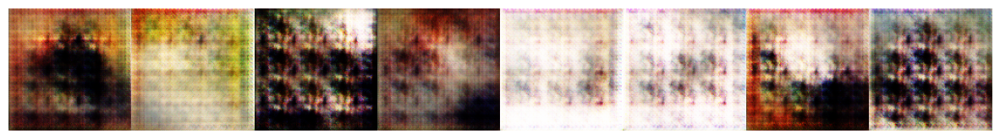

Epoch [   11/  100] | d_loss: 0.7623 | g_loss: 3.1344
Epoch [   12/  100] | d_loss: 0.7399 | g_loss: 2.5216
Epoch [   13/  100] | d_loss: 0.8620 | g_loss: 2.7837
Epoch [   14/  100] | d_loss: 1.1907 | g_loss: 2.1628
Epoch [   15/  100] | d_loss: 1.1257 | g_loss: 1.6577
Epoch [   16/  100] | d_loss: 0.7935 | g_loss: 2.4231
Epoch [   17/  100] | d_loss: 0.9715 | g_loss: 1.1129
Epoch [   18/  100] | d_loss: 0.7315 | g_loss: 3.4857
Epoch [   19/  100] | d_loss: 1.6048 | g_loss: 4.3189
Epoch [   20/  100] | d_loss: 0.7641 | g_loss: 2.0920


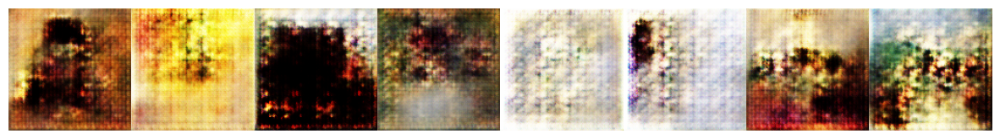

Epoch [   21/  100] | d_loss: 1.0809 | g_loss: 4.5022
Epoch [   22/  100] | d_loss: 0.5562 | g_loss: 3.2125
Epoch [   23/  100] | d_loss: 0.4688 | g_loss: 3.1831
Epoch [   24/  100] | d_loss: 0.5989 | g_loss: 2.5425
Epoch [   25/  100] | d_loss: 0.5794 | g_loss: 3.1095
Epoch [   26/  100] | d_loss: 0.5605 | g_loss: 4.0161
Epoch [   27/  100] | d_loss: 0.6183 | g_loss: 3.3463
Epoch [   28/  100] | d_loss: 0.6368 | g_loss: 3.6354
Epoch [   29/  100] | d_loss: 0.7823 | g_loss: 3.4651
Epoch [   30/  100] | d_loss: 0.4511 | g_loss: 3.9060


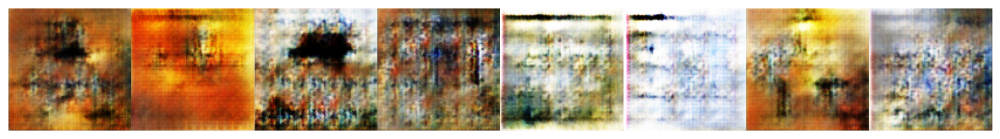

Epoch [   31/  100] | d_loss: 0.4560 | g_loss: 3.3168
Epoch [   32/  100] | d_loss: 0.6287 | g_loss: 3.9146
Epoch [   33/  100] | d_loss: 0.5423 | g_loss: 3.4111
Epoch [   34/  100] | d_loss: 0.7292 | g_loss: 4.5565
Epoch [   35/  100] | d_loss: 0.6243 | g_loss: 1.6726
Epoch [   36/  100] | d_loss: 0.5422 | g_loss: 2.5469
Epoch [   37/  100] | d_loss: 0.4998 | g_loss: 2.8055
Epoch [   38/  100] | d_loss: 0.4973 | g_loss: 2.8008
Epoch [   39/  100] | d_loss: 0.6202 | g_loss: 3.7633
Epoch [   40/  100] | d_loss: 0.6828 | g_loss: 4.1253


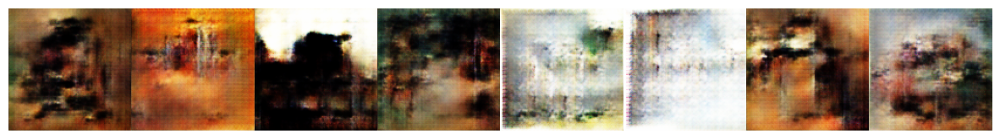

Epoch [   41/  100] | d_loss: 0.9360 | g_loss: 1.0433
Epoch [   42/  100] | d_loss: 0.5424 | g_loss: 2.4924
Epoch [   43/  100] | d_loss: 0.5311 | g_loss: 3.7493
Epoch [   44/  100] | d_loss: 0.5060 | g_loss: 2.9400
Epoch [   45/  100] | d_loss: 0.6707 | g_loss: 4.2657
Epoch [   46/  100] | d_loss: 0.5997 | g_loss: 1.9208
Epoch [   47/  100] | d_loss: 0.7727 | g_loss: 1.7459
Epoch [   48/  100] | d_loss: 0.9037 | g_loss: 1.4864
Epoch [   49/  100] | d_loss: 0.8937 | g_loss: 3.5987
Epoch [   50/  100] | d_loss: 0.7103 | g_loss: 1.9630


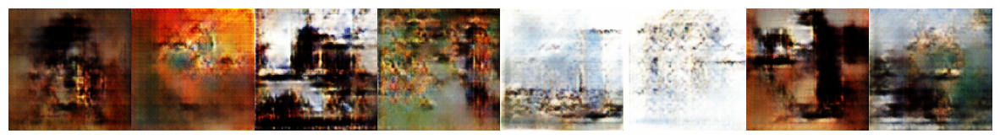

Epoch [   51/  100] | d_loss: 0.7281 | g_loss: 3.7848
Epoch [   52/  100] | d_loss: 0.6596 | g_loss: 4.6217
Epoch [   53/  100] | d_loss: 0.4017 | g_loss: 6.1017
Epoch [   54/  100] | d_loss: 0.5055 | g_loss: 3.5760
Epoch [   55/  100] | d_loss: 0.4051 | g_loss: 3.9110
Epoch [   56/  100] | d_loss: 0.7838 | g_loss: 5.1918
Epoch [   57/  100] | d_loss: 0.4606 | g_loss: 4.0414
Epoch [   58/  100] | d_loss: 0.8630 | g_loss: 4.1928
Epoch [   59/  100] | d_loss: 0.4326 | g_loss: 4.2225
Epoch [   60/  100] | d_loss: 0.7410 | g_loss: 1.4694


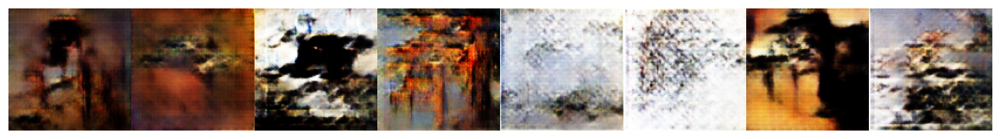

Epoch [   61/  100] | d_loss: 0.5394 | g_loss: 2.4737
Epoch [   62/  100] | d_loss: 0.6424 | g_loss: 2.6980
Epoch [   63/  100] | d_loss: 0.5424 | g_loss: 2.4026
Epoch [   64/  100] | d_loss: 1.3536 | g_loss: 4.7542
Epoch [   65/  100] | d_loss: 0.5658 | g_loss: 2.5942
Epoch [   66/  100] | d_loss: 0.4952 | g_loss: 3.6976
Epoch [   67/  100] | d_loss: 0.5635 | g_loss: 2.9380
Epoch [   68/  100] | d_loss: 0.5803 | g_loss: 2.5735
Epoch [   69/  100] | d_loss: 0.7985 | g_loss: 3.0991
Epoch [   70/  100] | d_loss: 0.8085 | g_loss: 1.4730


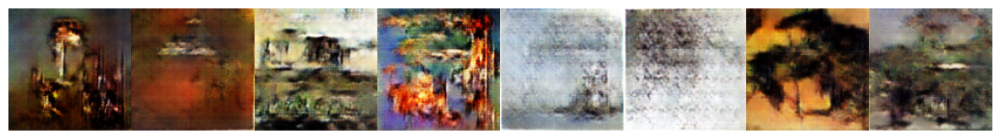

Epoch [   71/  100] | d_loss: 0.4580 | g_loss: 3.0267
Epoch [   72/  100] | d_loss: 0.4553 | g_loss: 4.1026
Epoch [   73/  100] | d_loss: 0.6457 | g_loss: 2.4935
Epoch [   74/  100] | d_loss: 0.7146 | g_loss: 4.3101
Epoch [   75/  100] | d_loss: 0.4593 | g_loss: 3.7815
Epoch [   76/  100] | d_loss: 0.3926 | g_loss: 4.3482
Epoch [   77/  100] | d_loss: 0.5936 | g_loss: 2.2926
Epoch [   78/  100] | d_loss: 0.8017 | g_loss: 4.5263
Epoch [   79/  100] | d_loss: 0.4913 | g_loss: 4.0751
Epoch [   80/  100] | d_loss: 0.5779 | g_loss: 4.2739


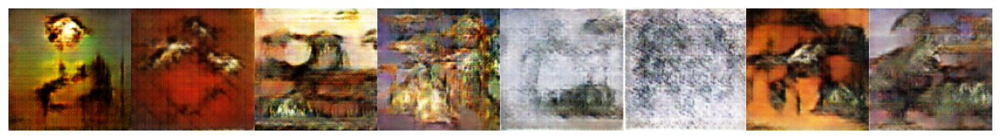

Epoch [   81/  100] | d_loss: 0.5073 | g_loss: 3.4294
Epoch [   82/  100] | d_loss: 0.5936 | g_loss: 4.0439
Epoch [   83/  100] | d_loss: 0.7739 | g_loss: 4.2318
Epoch [   84/  100] | d_loss: 0.4761 | g_loss: 2.3600
Epoch [   85/  100] | d_loss: 0.5867 | g_loss: 3.2052
Epoch [   86/  100] | d_loss: 0.7560 | g_loss: 1.7506
Epoch [   87/  100] | d_loss: 0.4362 | g_loss: 3.5391
Epoch [   88/  100] | d_loss: 0.5687 | g_loss: 4.2836
Epoch [   89/  100] | d_loss: 0.4200 | g_loss: 3.5563
Epoch [   90/  100] | d_loss: 0.5460 | g_loss: 2.2543


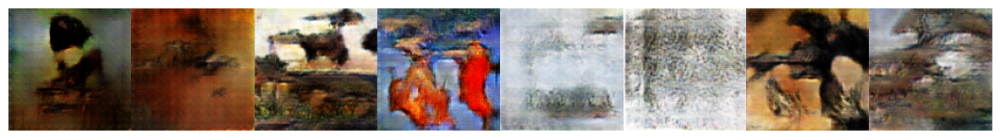

Epoch [   91/  100] | d_loss: 0.4761 | g_loss: 3.1666
Epoch [   92/  100] | d_loss: 0.4746 | g_loss: 3.3541
Epoch [   93/  100] | d_loss: 0.4829 | g_loss: 3.2510
Epoch [   94/  100] | d_loss: 0.4100 | g_loss: 2.9847
Epoch [   95/  100] | d_loss: 0.9462 | g_loss: 0.5184
Epoch [   96/  100] | d_loss: 0.6376 | g_loss: 2.8281
Epoch [   97/  100] | d_loss: 0.8990 | g_loss: 3.5953
Epoch [   98/  100] | d_loss: 0.8955 | g_loss: 2.2100
Epoch [   99/  100] | d_loss: 0.6102 | g_loss: 2.5938
Epoch [  100/  100] | d_loss: 0.4959 | g_loss: 2.3064


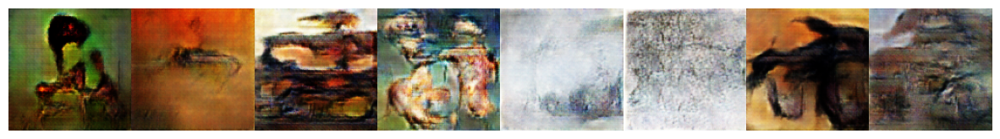

In [ ]:
n_epochs = 100
train(
    disc,gen,
    n_epochs,dataloader,
    d_optimizer,g_optimizer,
    z_dim,
    print_every=10,
    device='cuda',
)

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds

Found 8683 files belonging to 1 classes.


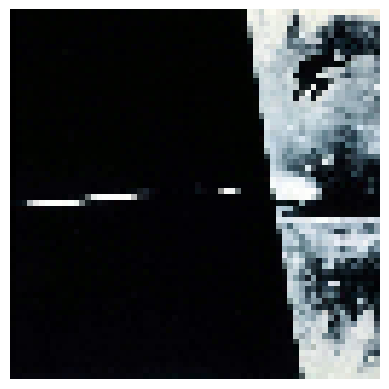

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt

def get_dataloader_tf(batch_size, image_size, data_dir):
    def preprocess_image(image, label):
        image = tf.image.resize(image, [image_size, image_size])
        image = tf.cast(image, tf.float32)
        image = (image - 127.5) / 127.5
        return image, label

    data = tf.keras.preprocessing.image_dataset_from_directory(
        data_dir,
        label_mode='int',
        image_size=(image_size, image_size),
        batch_size=batch_size
    )

    data = data.map(preprocess_image).prefetch(tf.data.experimental.AUTOTUNE)

    return data

def tensor_imshow(image):
    plt.imshow((image.numpy() * 127.5 + 127.5).astype("uint8"))
    plt.axis("off")
    plt.show()

# Testing the dataloader
image_root = 'resized'

batch_size, image_size = 5, 64
train_loader = get_dataloader_tf(batch_size, image_size, image_root)
dataiter = iter(train_loader)

img, _ = next(dataiter)
sample_img = img[-1]
tensor_imshow(sample_img)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.generator = tf.keras.Sequential([
            tf.keras.layers.Dense(4*4*512, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Reshape((4, 4, 512)),

            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def call(self, noise):
        x = tf.reshape(noise, [-1, self.z_dim])
        return self.generator(x)

    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = [
            tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
        ]

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



In [ ]:
def weights_init_normal(layer):
    if isinstance(layer, tf.keras.layers.Conv2D) or isinstance(layer, tf.keras.layers.Conv2DTranspose):
        layer.set_weights([tf.random.normal(layer.get_weights()[0].shape, mean=0.0, stddev=0.02)])
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.set_weights([
            tf.random.normal(layer.get_weights()[0].shape, mean=0.0, stddev=0.02),
            tf.zeros_like(layer.get_weights()[1])
        ])

def apply_weight_init(model):
    for layer in model.layers:
        weights_init_normal(layer)



In [ ]:
generator = Generator()
apply_weight_init(generator)

discriminator = Discriminator()
apply_weight_init(discriminator)


In [ ]:
def real_loss(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.ones((batch_size, 1), dtype=tf.float32) * 0.9  # real labels = 1 and label smoothing => 0.9

    loss = criterion(labels, D_out)
    return loss

def fake_loss(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.zeros((batch_size, 1), dtype=tf.float32)  # fake labels = 0

    loss = criterion(labels, D_out)
    return loss


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    plt.subplots_adjust(wspace=0, hspace=0)
    
    npimgs = images_tensor.numpy()
    
    no_plots = len(npimgs)

    for idx, image in enumerate(npimgs):
        plt.subplot(1, 8, idx+1)
        plt.axis('off')
        # dnorm
        image = image * 0.5 + 0.5
        plt.imshow(image)  # Removed np.transpose
    plt.show()

def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=50):
    
    ## Get some fixed data for sampling.##      
    sample_size = 8
    fixed_z = get_noise(n_samples=sample_size, z_dim=z_dim)
    
    for epoch in range(1, n_epochs+1):
        for batch_i, (real_images, _) in enumerate(dataloader):
            batch_size = real_images.shape[0]
            
            ### Discriminator part ###
            with tf.GradientTape() as tape:
                # Loss on real image
                d_real_op = D(real_images)
                d_real_loss = real_loss(d_real_op)
                
                # Loss on fake image
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                fake_images = G(noise)
                d_fake_op = D(fake_images)
                d_fake_loss = fake_loss(d_fake_op)
                
                # Total loss
                d_loss = d_real_loss + d_fake_loss

            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))
            
            ### Generator part ###
            with tf.GradientTape() as tape:
                noise = get_noise(n_samples=batch_size, z_dim=z_dim)
                g_out = G(noise)
                d_out = D(g_out)
                
                g_loss = real_loss(d_out)

            gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(gradients, G.trainable_variables))
        
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))
        if (epoch % print_every == 0):
            G.trainable = False
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.trainable = True


In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0008
batch_size = 128
image_size = 128


Device is GPU


In [ ]:
# Model initialization
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_g, beta_1=beta_1, beta_2=beta_2)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta_1, beta_2=beta_2)

dataloader = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


In [ ]:
def get_noise(n_samples, z_dim, seed=None):
    if seed is not None:
        tf.random.set_seed(seed)
    return tf.random.normal([n_samples, z_dim])


In [ ]:
noise = Generator.get_noise(n_samples=128, z_dim=z_dim)


Epoch [    1/  100] | d_loss: 1.5481 | g_loss: 1.6869
Epoch [    2/  100] | d_loss: 1.3620 | g_loss: 1.1479
Epoch [    3/  100] | d_loss: 1.2901 | g_loss: 1.0389
Epoch [    4/  100] | d_loss: 1.5047 | g_loss: 0.5785
Epoch [    5/  100] | d_loss: 1.2768 | g_loss: 0.8832
Epoch [    6/  100] | d_loss: 1.3503 | g_loss: 0.8840
Epoch [    7/  100] | d_loss: 1.3136 | g_loss: 0.8975
Epoch [    8/  100] | d_loss: 1.3096 | g_loss: 0.9239
Epoch [    9/  100] | d_loss: 1.3300 | g_loss: 0.9894
Epoch [   10/  100] | d_loss: 1.3567 | g_loss: 0.8734


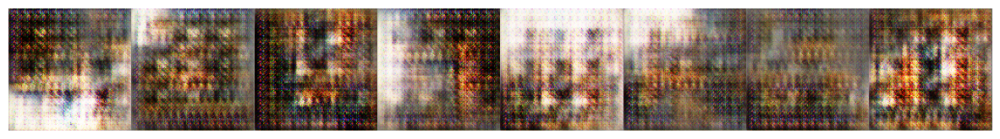

Epoch [   11/  100] | d_loss: 1.4270 | g_loss: 0.9009
Epoch [   12/  100] | d_loss: 1.2932 | g_loss: 1.2916
Epoch [   13/  100] | d_loss: 1.4633 | g_loss: 0.9876
Epoch [   14/  100] | d_loss: 1.3490 | g_loss: 0.7364
Epoch [   15/  100] | d_loss: 1.3210 | g_loss: 0.8713
Epoch [   16/  100] | d_loss: 1.3030 | g_loss: 0.9029
Epoch [   17/  100] | d_loss: 1.3041 | g_loss: 0.9438
Epoch [   18/  100] | d_loss: 1.3577 | g_loss: 0.8790
Epoch [   19/  100] | d_loss: 1.3877 | g_loss: 0.7500
Epoch [   20/  100] | d_loss: 1.3608 | g_loss: 0.7742


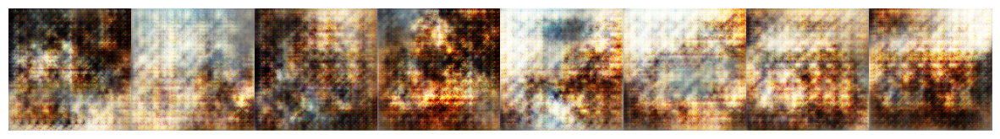

Epoch [   21/  100] | d_loss: 1.3799 | g_loss: 0.7717
Epoch [   22/  100] | d_loss: 1.3662 | g_loss: 0.9228
Epoch [   23/  100] | d_loss: 1.2909 | g_loss: 1.0796
Epoch [   24/  100] | d_loss: 1.3626 | g_loss: 0.8058
Epoch [   25/  100] | d_loss: 1.3776 | g_loss: 0.9973
Epoch [   26/  100] | d_loss: 1.6338 | g_loss: 0.8967
Epoch [   27/  100] | d_loss: 1.2931 | g_loss: 0.9267
Epoch [   28/  100] | d_loss: 1.4002 | g_loss: 0.8295
Epoch [   29/  100] | d_loss: 1.4560 | g_loss: 0.7652
Epoch [   30/  100] | d_loss: 1.3297 | g_loss: 0.7588


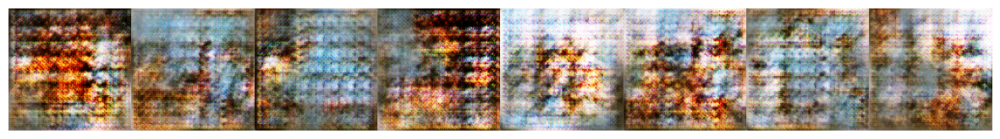

Epoch [   31/  100] | d_loss: 1.3748 | g_loss: 0.8006
Epoch [   32/  100] | d_loss: 1.3630 | g_loss: 0.8677
Epoch [   33/  100] | d_loss: 1.3980 | g_loss: 0.8852
Epoch [   34/  100] | d_loss: 1.3658 | g_loss: 0.8378
Epoch [   35/  100] | d_loss: 1.4462 | g_loss: 0.9717
Epoch [   36/  100] | d_loss: 1.3762 | g_loss: 0.8887
Epoch [   37/  100] | d_loss: 1.4184 | g_loss: 1.0063
Epoch [   38/  100] | d_loss: 1.3486 | g_loss: 0.8310
Epoch [   39/  100] | d_loss: 1.3457 | g_loss: 0.8017
Epoch [   40/  100] | d_loss: 1.2872 | g_loss: 1.0319


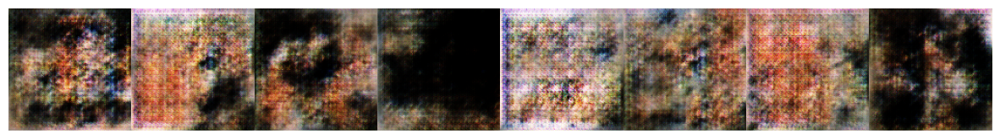

Epoch [   41/  100] | d_loss: 1.3378 | g_loss: 0.9346
Epoch [   42/  100] | d_loss: 1.3732 | g_loss: 0.9350
Epoch [   43/  100] | d_loss: 1.3445 | g_loss: 0.8359
Epoch [   44/  100] | d_loss: 1.3480 | g_loss: 0.8453
Epoch [   45/  100] | d_loss: 1.3535 | g_loss: 0.8560
Epoch [   46/  100] | d_loss: 1.3493 | g_loss: 0.7999
Epoch [   47/  100] | d_loss: 1.3371 | g_loss: 0.8578
Epoch [   48/  100] | d_loss: 1.3473 | g_loss: 0.9200
Epoch [   49/  100] | d_loss: 1.3419 | g_loss: 0.8036
Epoch [   50/  100] | d_loss: 1.3228 | g_loss: 0.8617


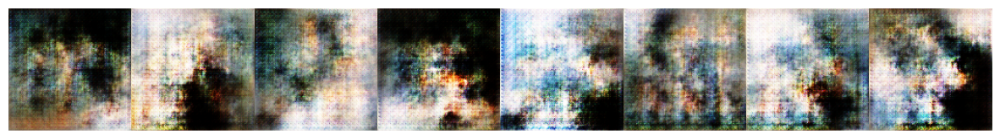

Epoch [   51/  100] | d_loss: 1.3917 | g_loss: 0.7916
Epoch [   52/  100] | d_loss: 1.3172 | g_loss: 1.1257
Epoch [   53/  100] | d_loss: 1.3289 | g_loss: 0.9253
Epoch [   54/  100] | d_loss: 1.5443 | g_loss: 0.8139
Epoch [   55/  100] | d_loss: 1.3814 | g_loss: 0.8141
Epoch [   56/  100] | d_loss: 1.2846 | g_loss: 0.8543
Epoch [   57/  100] | d_loss: 1.3532 | g_loss: 0.9378
Epoch [   58/  100] | d_loss: 1.3884 | g_loss: 0.8166
Epoch [   59/  100] | d_loss: 1.3513 | g_loss: 0.9038
Epoch [   60/  100] | d_loss: 1.3853 | g_loss: 0.8489


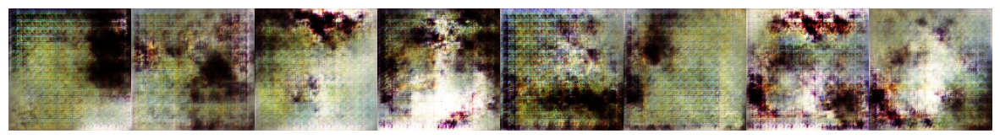

Epoch [   61/  100] | d_loss: 1.3399 | g_loss: 0.9498
Epoch [   62/  100] | d_loss: 1.2973 | g_loss: 1.0044
Epoch [   63/  100] | d_loss: 1.2739 | g_loss: 0.9745
Epoch [   64/  100] | d_loss: 1.2282 | g_loss: 0.8908
Epoch [   65/  100] | d_loss: 1.3934 | g_loss: 0.8192
Epoch [   66/  100] | d_loss: 1.2993 | g_loss: 0.8465
Epoch [   67/  100] | d_loss: 1.4264 | g_loss: 0.8778
Epoch [   68/  100] | d_loss: 1.3600 | g_loss: 0.7557
Epoch [   69/  100] | d_loss: 1.3482 | g_loss: 0.9643
Epoch [   70/  100] | d_loss: 1.2871 | g_loss: 0.8321


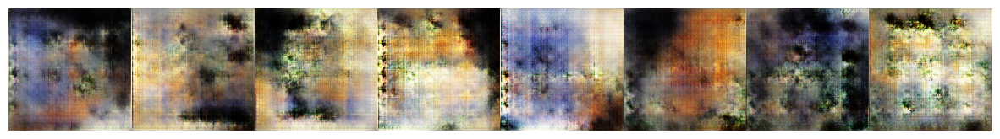

Epoch [   71/  100] | d_loss: 1.3328 | g_loss: 0.8204
Epoch [   72/  100] | d_loss: 1.3489 | g_loss: 0.8258
Epoch [   73/  100] | d_loss: 1.3039 | g_loss: 0.9694
Epoch [   74/  100] | d_loss: 1.2835 | g_loss: 0.9615
Epoch [   75/  100] | d_loss: 1.2189 | g_loss: 1.0303
Epoch [   76/  100] | d_loss: 1.2925 | g_loss: 0.7955
Epoch [   77/  100] | d_loss: 1.3301 | g_loss: 0.7696
Epoch [   78/  100] | d_loss: 1.3267 | g_loss: 0.9529
Epoch [   79/  100] | d_loss: 1.2973 | g_loss: 0.8837
Epoch [   80/  100] | d_loss: 1.3663 | g_loss: 1.0245


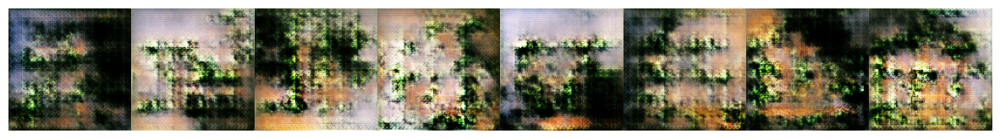

Epoch [   81/  100] | d_loss: 1.2838 | g_loss: 0.9756
Epoch [   82/  100] | d_loss: 1.2997 | g_loss: 0.8221
Epoch [   83/  100] | d_loss: 1.3343 | g_loss: 1.0226
Epoch [   84/  100] | d_loss: 1.3430 | g_loss: 0.9741
Epoch [   85/  100] | d_loss: 1.1517 | g_loss: 1.2976
Epoch [   86/  100] | d_loss: 1.2276 | g_loss: 1.0174
Epoch [   87/  100] | d_loss: 1.2804 | g_loss: 1.1044
Epoch [   88/  100] | d_loss: 1.2318 | g_loss: 1.0481
Epoch [   89/  100] | d_loss: 1.2347 | g_loss: 1.0034
Epoch [   90/  100] | d_loss: 1.2966 | g_loss: 1.0522


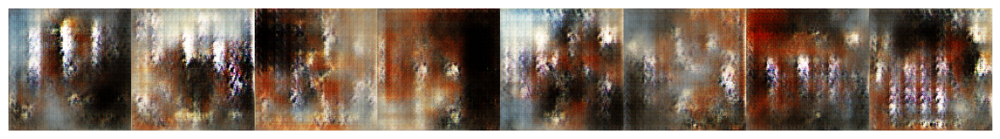

Epoch [   91/  100] | d_loss: 1.0731 | g_loss: 1.2982
Epoch [   92/  100] | d_loss: 1.0587 | g_loss: 1.3526
Epoch [   93/  100] | d_loss: 1.1360 | g_loss: 1.2977
Epoch [   94/  100] | d_loss: 1.1805 | g_loss: 1.6959
Epoch [   95/  100] | d_loss: 1.1442 | g_loss: 1.5520
Epoch [   96/  100] | d_loss: 1.2366 | g_loss: 1.1255
Epoch [   97/  100] | d_loss: 1.4445 | g_loss: 1.6203
Epoch [   98/  100] | d_loss: 1.0454 | g_loss: 1.4809
Epoch [   99/  100] | d_loss: 1.1381 | g_loss: 1.3291
Epoch [  100/  100] | d_loss: 0.9910 | g_loss: 1.6501


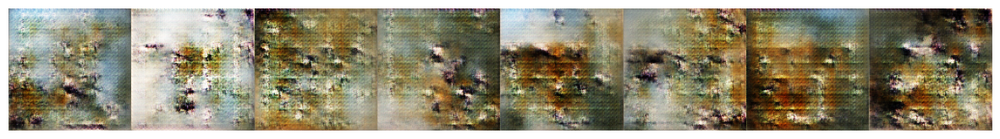

In [ ]:
n_epochs = 100
train(
    disc, gen,
    n_epochs, dataloader,
    d_optimizer, g_optimizer,
    z_dim,
    print_every=10,
)


In [ ]:
def real_loss_tf(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.ones((batch_size, 1), dtype=tf.float32) * 0.9  # real labels = 1 and label smoothing => 0.9

    loss = criterion(labels, D_out)
    return loss

def fake_loss_tf(D_out, device='cpu'):
    criterion = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    batch_size = D_out.shape[0]
    labels = tf.zeros((batch_size, 1), dtype=tf.float32)  # fake labels = 0

    loss = criterion(labels, D_out)
    return loss


In [ ]:
import tensorflow as tf

def train_tf(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=50, device='cpu'):

    @tf.function
    def train_step(real_images):
        batch_size = real_images.shape[0]
        noise = tf.random.normal([batch_size, z_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            # Generate fake images
            fake_images = G(noise, training=True)

            # Discriminator outputs
            d_real_op = D(real_images, training=True)
            d_fake_op = D(fake_images, training=True)

            # Calculate losses
            d_real_loss = real_loss_tf(d_real_op)
            d_fake_loss = fake_loss_tf(d_fake_op)
            d_loss = d_real_loss + d_fake_loss
            g_loss = real_loss_tf(d_fake_op)

        # Calculate gradients
        gen_gradients = gen_tape.gradient(g_loss, G.trainable_variables)
        disc_gradients = disc_tape.gradient(d_loss, D.trainable_variables)

        # Apply gradients
        g_optimizer.apply_gradients(zip(gen_gradients, G.trainable_variables))
        d_optimizer.apply_gradients(zip(disc_gradients, D.trainable_variables))

        return d_loss, g_loss

    # Get some fixed data for sampling.
    sample_size = 8
    fixed_z = tf.random.normal([sample_size, z_dim])

    for epoch in range(1, n_epochs + 1):
        for batch_i, (real_images, _) in enumerate(dataloader):
            real_images = real_images.numpy()
            d_loss, g_loss = train_step(real_images)

        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
            epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))

        if (epoch % print_every == 0):
            G.eval()
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.train()


In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999
# change learning rate equal for generator and discriminator.
n_epochs = 150
lr = 0.0002
lr_g = 0.0002
batch_size = 128
image_size = 128


Device is GPU


In [ ]:
# Model initialization
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_g, beta_1=beta_1, beta_2=beta_2)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta_1, beta_2=beta_2)

dataloader = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


In [ ]:
def get_noise(n_samples, z_dim, seed=None):
    if seed is not None:
        tf.random.set_seed(seed)
    return tf.random.normal([n_samples, z_dim])


Epoch [    1/  100] | d_loss: 0.4630 | g_loss: 3.5908
Epoch [    2/  100] | d_loss: 0.4161 | g_loss: 4.1800
Epoch [    3/  100] | d_loss: 0.5728 | g_loss: 1.9385
Epoch [    4/  100] | d_loss: 0.5719 | g_loss: 3.6429
Epoch [    5/  100] | d_loss: 0.4602 | g_loss: 4.1953
Epoch [    6/  100] | d_loss: 0.4280 | g_loss: 3.5346
Epoch [    7/  100] | d_loss: 0.4293 | g_loss: 3.4779
Epoch [    8/  100] | d_loss: 0.6375 | g_loss: 4.8275
Epoch [    9/  100] | d_loss: 0.9054 | g_loss: 3.0106
Epoch [   10/  100] | d_loss: 0.7425 | g_loss: 2.3055


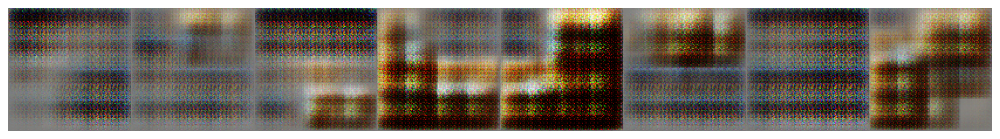

Epoch [   11/  100] | d_loss: 0.6741 | g_loss: 2.6266
Epoch [   12/  100] | d_loss: 0.6575 | g_loss: 2.3484
Epoch [   13/  100] | d_loss: 0.7338 | g_loss: 2.9080
Epoch [   14/  100] | d_loss: 0.7108 | g_loss: 2.6143
Epoch [   15/  100] | d_loss: 0.9472 | g_loss: 1.7610
Epoch [   16/  100] | d_loss: 0.9739 | g_loss: 1.8544
Epoch [   17/  100] | d_loss: 0.7480 | g_loss: 2.1492
Epoch [   18/  100] | d_loss: 0.7638 | g_loss: 2.2309
Epoch [   19/  100] | d_loss: 0.7728 | g_loss: 2.2795
Epoch [   20/  100] | d_loss: 0.7901 | g_loss: 2.3696


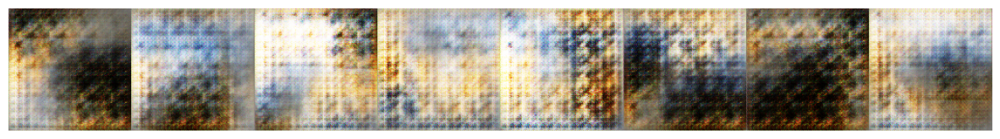

Epoch [   21/  100] | d_loss: 0.8739 | g_loss: 1.9653
Epoch [   22/  100] | d_loss: 0.7901 | g_loss: 2.6489
Epoch [   23/  100] | d_loss: 0.8052 | g_loss: 2.2548
Epoch [   24/  100] | d_loss: 0.9810 | g_loss: 1.8879
Epoch [   25/  100] | d_loss: 0.9362 | g_loss: 2.7364
Epoch [   26/  100] | d_loss: 0.8099 | g_loss: 2.2884
Epoch [   27/  100] | d_loss: 1.0169 | g_loss: 2.2986
Epoch [   28/  100] | d_loss: 0.9401 | g_loss: 2.3364
Epoch [   29/  100] | d_loss: 0.8983 | g_loss: 2.4889
Epoch [   30/  100] | d_loss: 0.9991 | g_loss: 2.6872


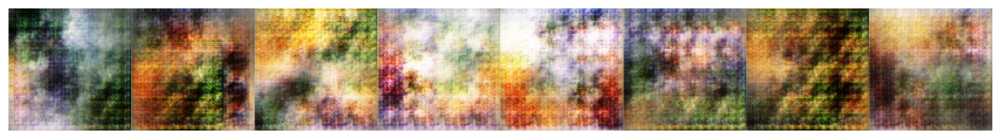

Epoch [   31/  100] | d_loss: 1.1267 | g_loss: 2.7265
Epoch [   32/  100] | d_loss: 0.8253 | g_loss: 3.1455
Epoch [   33/  100] | d_loss: 0.9235 | g_loss: 2.4048
Epoch [   34/  100] | d_loss: 0.9557 | g_loss: 2.6951
Epoch [   35/  100] | d_loss: 0.9548 | g_loss: 2.0907
Epoch [   36/  100] | d_loss: 1.1007 | g_loss: 3.9965
Epoch [   37/  100] | d_loss: 0.9483 | g_loss: 2.0018
Epoch [   38/  100] | d_loss: 0.9033 | g_loss: 2.6382
Epoch [   39/  100] | d_loss: 0.7409 | g_loss: 1.8851
Epoch [   40/  100] | d_loss: 0.9730 | g_loss: 3.4795


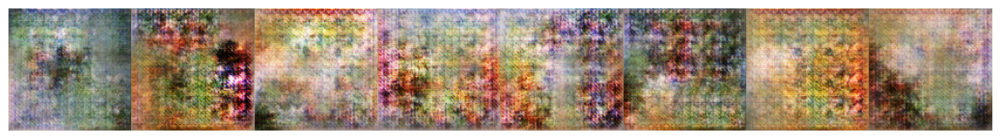

Epoch [   41/  100] | d_loss: 0.8784 | g_loss: 2.3616
Epoch [   42/  100] | d_loss: 0.8865 | g_loss: 3.3294
Epoch [   43/  100] | d_loss: 0.9264 | g_loss: 2.1497
Epoch [   44/  100] | d_loss: 1.0885 | g_loss: 1.6806
Epoch [   45/  100] | d_loss: 0.9426 | g_loss: 2.1345
Epoch [   46/  100] | d_loss: 0.8781 | g_loss: 3.5334
Epoch [   47/  100] | d_loss: 0.8398 | g_loss: 2.8048
Epoch [   48/  100] | d_loss: 0.7760 | g_loss: 2.7062
Epoch [   49/  100] | d_loss: 0.7139 | g_loss: 2.3903
Epoch [   50/  100] | d_loss: 0.7753 | g_loss: 3.0611


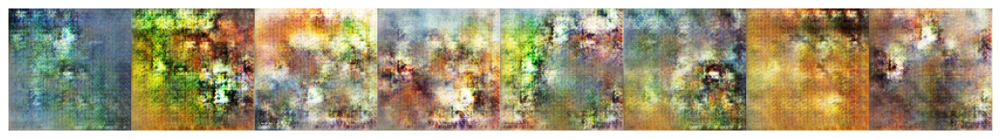

Epoch [   51/  100] | d_loss: 0.8674 | g_loss: 2.6950
Epoch [   52/  100] | d_loss: 0.8404 | g_loss: 3.1182
Epoch [   53/  100] | d_loss: 0.7843 | g_loss: 2.9304
Epoch [   54/  100] | d_loss: 0.8671 | g_loss: 2.2991
Epoch [   55/  100] | d_loss: 0.8174 | g_loss: 3.4079
Epoch [   56/  100] | d_loss: 0.9625 | g_loss: 3.1971
Epoch [   57/  100] | d_loss: 1.3219 | g_loss: 1.2282
Epoch [   58/  100] | d_loss: 0.7105 | g_loss: 3.1194
Epoch [   59/  100] | d_loss: 0.7702 | g_loss: 2.0751
Epoch [   60/  100] | d_loss: 0.7748 | g_loss: 2.7277


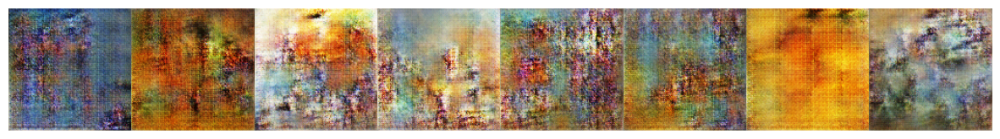

Epoch [   61/  100] | d_loss: 0.7152 | g_loss: 3.4557
Epoch [   62/  100] | d_loss: 0.7643 | g_loss: 2.8462
Epoch [   63/  100] | d_loss: 0.8453 | g_loss: 3.0428
Epoch [   64/  100] | d_loss: 0.8789 | g_loss: 2.4717
Epoch [   65/  100] | d_loss: 0.8078 | g_loss: 2.4575
Epoch [   66/  100] | d_loss: 0.6646 | g_loss: 2.8070
Epoch [   67/  100] | d_loss: 0.8960 | g_loss: 2.4125
Epoch [   68/  100] | d_loss: 0.8346 | g_loss: 2.4958
Epoch [   69/  100] | d_loss: 0.8105 | g_loss: 2.6179
Epoch [   70/  100] | d_loss: 0.7782 | g_loss: 2.9804


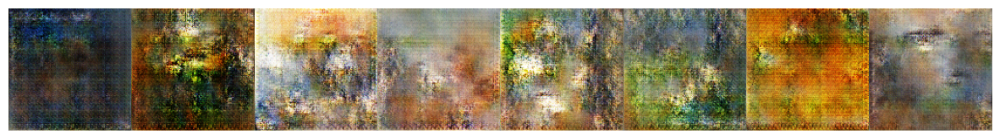

Epoch [   71/  100] | d_loss: 0.7980 | g_loss: 3.3281
Epoch [   72/  100] | d_loss: 0.7553 | g_loss: 2.7212
Epoch [   73/  100] | d_loss: 0.7142 | g_loss: 2.9443
Epoch [   74/  100] | d_loss: 0.7300 | g_loss: 3.0271
Epoch [   75/  100] | d_loss: 0.7788 | g_loss: 3.5030
Epoch [   76/  100] | d_loss: 0.7429 | g_loss: 2.5521
Epoch [   77/  100] | d_loss: 0.6719 | g_loss: 2.8046
Epoch [   78/  100] | d_loss: 0.8133 | g_loss: 2.4060
Epoch [   79/  100] | d_loss: 0.6692 | g_loss: 3.5516
Epoch [   80/  100] | d_loss: 0.8276 | g_loss: 2.4160


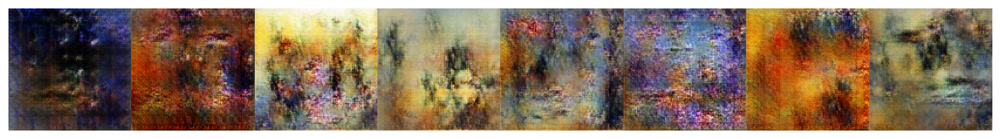

Epoch [   81/  100] | d_loss: 0.6979 | g_loss: 2.7947
Epoch [   82/  100] | d_loss: 0.6808 | g_loss: 3.3559
Epoch [   83/  100] | d_loss: 0.7956 | g_loss: 3.0978
Epoch [   84/  100] | d_loss: 0.7437 | g_loss: 2.8455
Epoch [   85/  100] | d_loss: 0.7504 | g_loss: 3.7558
Epoch [   86/  100] | d_loss: 0.6645 | g_loss: 3.3137
Epoch [   87/  100] | d_loss: 0.9005 | g_loss: 1.5375
Epoch [   88/  100] | d_loss: 0.6888 | g_loss: 3.1265
Epoch [   89/  100] | d_loss: 0.6750 | g_loss: 2.9497
Epoch [   90/  100] | d_loss: 0.7295 | g_loss: 3.0561


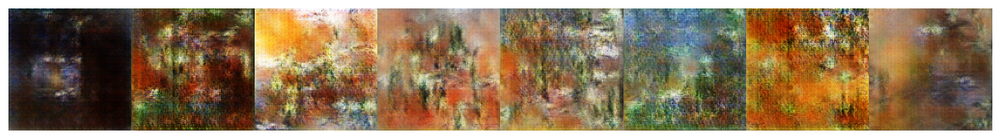

Epoch [   91/  100] | d_loss: 0.7300 | g_loss: 3.3741
Epoch [   92/  100] | d_loss: 0.7547 | g_loss: 2.7773
Epoch [   93/  100] | d_loss: 0.7090 | g_loss: 2.9731
Epoch [   94/  100] | d_loss: 0.6755 | g_loss: 2.9151
Epoch [   95/  100] | d_loss: 0.7349 | g_loss: 2.6381
Epoch [   96/  100] | d_loss: 0.7231 | g_loss: 2.6749
Epoch [   97/  100] | d_loss: 0.6791 | g_loss: 2.8354
Epoch [   98/  100] | d_loss: 0.6584 | g_loss: 2.3727
Epoch [   99/  100] | d_loss: 0.7720 | g_loss: 3.1034
Epoch [  100/  100] | d_loss: 0.6614 | g_loss: 2.7492


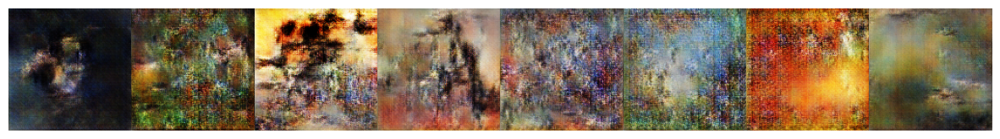

In [ ]:
n_epochs = 100
train(
    disc, gen,
    n_epochs, dataloader,
    d_optimizer, g_optimizer,
    z_dim,
    print_every=10,
)


In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999
# change learning rate double for generator to discriminator.
n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128


Device is GPU


In [ ]:
# Model initialization
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.Adam(learning_rate=lr_g, beta_1=beta_1, beta_2=beta_2)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=lr, beta_1=beta_1, beta_2=beta_2)

dataloader = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


In [ ]:
def get_noise(n_samples, z_dim, seed=None):
    if seed is not None:
        tf.random.set_seed(seed)
    return tf.random.normal([n_samples, z_dim])


Epoch [    1/  100] | d_loss: 0.7033 | g_loss: 4.2111
Epoch [    2/  100] | d_loss: 0.7155 | g_loss: 2.4036
Epoch [    3/  100] | d_loss: 1.0938 | g_loss: 1.5146
Epoch [    4/  100] | d_loss: 1.0761 | g_loss: 1.3719
Epoch [    5/  100] | d_loss: 1.0079 | g_loss: 1.0780
Epoch [    6/  100] | d_loss: 1.2117 | g_loss: 1.1092
Epoch [    7/  100] | d_loss: 1.4093 | g_loss: 0.9949
Epoch [    8/  100] | d_loss: 1.0818 | g_loss: 1.4254
Epoch [    9/  100] | d_loss: 1.2627 | g_loss: 1.0357
Epoch [   10/  100] | d_loss: 1.2478 | g_loss: 1.9279


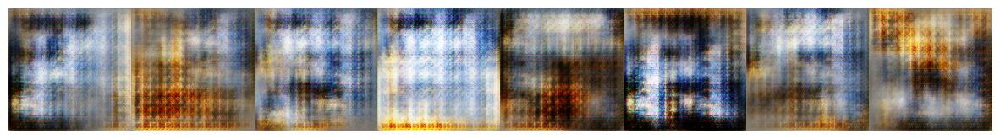

Epoch [   11/  100] | d_loss: 1.2043 | g_loss: 1.0687
Epoch [   12/  100] | d_loss: 1.3312 | g_loss: 1.2272


In [ ]:
n_epochs = 100
train(
    disc, gen,
    n_epochs, dataloader,
    d_optimizer, g_optimizer,
    z_dim,
    print_every=10,
)


In [ ]:
def wasserstein_loss(y_true, y_pred):
    return tf.reduce_mean(y_true * y_pred)
def real_loss(D_out):
    return wasserstein_loss(tf.ones_like(D_out), D_out)

def fake_loss(D_out):
    return wasserstein_loss(-tf.ones_like(D_out), D_out)
def gradient_penalty(real_images, fake_images, discriminator):
    batch_size = real_images.shape[0]
    epsilon = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated_images = epsilon * real_images + (1 - epsilon) * fake_images
    with tf.GradientTape() as tape:
        tape.watch(interpolated_images)
        pred = discriminator(interpolated_images)

    gradients = tape.gradient(pred, interpolated_images)
    gradients_norm = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2, 3]))
    penalty = tf.reduce_mean((gradients_norm - 1.0) ** 2)
    return penalty



In [ ]:
!pip install tensorflow-addons
import tensorflow_addons as tfa

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim

        self.generator = tf.keras.Sequential([
            tf.keras.layers.Dense(4*4*512, use_bias=False, input_shape=(z_dim,)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Reshape((4, 4, 512)),

            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def call(self, noise):
        x = tf.reshape(noise, [-1, self.z_dim])
        return self.generator(x)

    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers_list = [
            tfa.layers.SpectralNormalization(
                tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
            )
        ]

        if not final_layer:
            layers_list.append(tf.keras.layers.BatchNormalization())
            layers_list.append(tf.keras.layers.LeakyReLU(0.2))
            layers_list.append(tf.keras.layers.Dropout(0.3))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers_list.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers_list)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def print_tensor_images(images_tensor):
    plt.rcParams['figure.figsize'] = (15, 15)
    
    npimgs = images_tensor.numpy()
    no_plots = len(npimgs)

    fig, axes = plt.subplots(1, no_plots, figsize=(15, 15), squeeze=False)
    for idx, ax in enumerate(axes.flatten()):
        image = npimgs[idx] * 0.5 + 0.5
        ax.imshow(image)
        ax.axis('off')
    plt.show()


def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=50, gp=10):
    
    ## Get some fixed data for sampling.##      
    sample_size = 8
    fixed_z = G.get_noise(n_samples=sample_size, z_dim=z_dim)
    
    for epoch in range(1, n_epochs+1):
        for batch_i, (real_images, _) in enumerate(dataloader):
            batch_size = real_images.shape[0]
            
            ### Discriminator part ###
            with tf.GradientTape(persistent=True) as tape:
                # Loss on real image
                d_real_op = D(real_images)
                d_real_loss = real_loss(d_real_op)
                
                # Loss on fake image
                noise = G.get_noise(n_samples=batch_size, z_dim=z_dim)
                fake_images = G(noise)
                d_fake_op = D(fake_images)
                d_fake_loss = fake_loss(d_fake_op)
                
                # Total loss
                d_loss = d_real_loss + d_fake_loss

                # Gradient penalty
                epsilon = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
                interpolated_images = epsilon * real_images + (1 - epsilon) * fake_images
                tape.watch(interpolated_images)
                d_interpolated_op = D(interpolated_images)
                gradients = tape.gradient(d_interpolated_op, interpolated_images)
                gradients_norm = tf.sqrt(tf.reduce_sum(tf.square(gradients), axis=[1, 2, 3]))
                gradient_penalty = tf.reduce_mean((gradients_norm - 1.0) ** 2)
                d_loss += gp * gradient_penalty
                
            gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(gradients, D.trainable_variables))
            del tape  # This is to delete the persistent gradient tape
            
            ### Generator part ###
            with tf.GradientTape() as tape:
                noise = G.get_noise(n_samples=batch_size, z_dim=z_dim)
                g_out = G(noise)
                d_out = D(g_out)
                
                g_loss = real_loss(d_out)

            gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(gradients, G.trainable_variables))
        
        
        print('Epoch [{:5d}/{:5d}] | d_loss: {:6.4f} | g_loss: {:6.4f}'.format(
                                epoch, n_epochs, d_loss.numpy(), g_loss.numpy()))
        if (epoch % print_every == 0):
            G.trainable = False
            sample_image = G(fixed_z)
            print_tensor_images(sample_image)
            G.trainable = True

        

In [ ]:
def get_noise(n_samples, z_dim):
    return tf.random.normal([n_samples, z_dim])


In [ ]:
# Model initialization
image_size = 128
z_dim = 150
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.RMSprop(learning_rate=lr_g)
d_optimizer = tf.keras.optimizers.RMSprop(learning_rate=lr)

train_dataset = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


In [ ]:
train_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

Device is GPU


Epoch [    1/  100] | d_loss: -166.3980 | g_loss: 56.6324
Epoch [    2/  100] | d_loss: -6.4188 | g_loss: 15.2273
Epoch [    3/  100] | d_loss: 23.8188 | g_loss: -28.6633
Epoch [    4/  100] | d_loss: -4.5661 | g_loss: 9.7028
Epoch [    5/  100] | d_loss: 4.1286 | g_loss: -1.7524


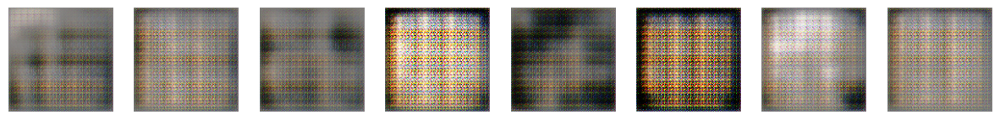

Epoch [    6/  100] | d_loss: -0.7603 | g_loss: 20.7945
Epoch [    7/  100] | d_loss: 1.9880 | g_loss: 3.2628
Epoch [    8/  100] | d_loss: 0.3969 | g_loss: 37.8762
Epoch [    9/  100] | d_loss: -0.8742 | g_loss: 31.7185
Epoch [   10/  100] | d_loss: -2.1215 | g_loss: 5.0502


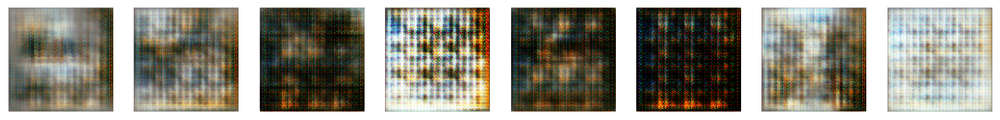

Epoch [   11/  100] | d_loss: 4.3650 | g_loss: 3.2178
Epoch [   12/  100] | d_loss: 3.1949 | g_loss: 8.0133
Epoch [   13/  100] | d_loss: 3.0879 | g_loss: 6.0279
Epoch [   14/  100] | d_loss: 2.5309 | g_loss: 0.8408
Epoch [   15/  100] | d_loss: 2.1621 | g_loss: 2.7502


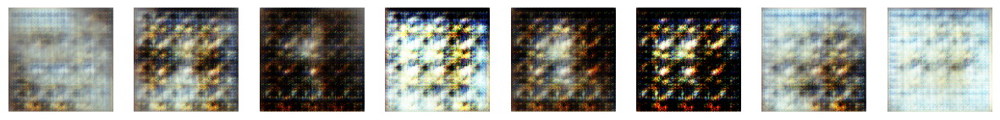

Epoch [   16/  100] | d_loss: 0.7550 | g_loss: 3.1798
Epoch [   17/  100] | d_loss: 1.9205 | g_loss: 3.9535
Epoch [   18/  100] | d_loss: 2.6307 | g_loss: 4.8623
Epoch [   19/  100] | d_loss: 0.2159 | g_loss: 15.3843
Epoch [   20/  100] | d_loss: 1.0112 | g_loss: 11.4769


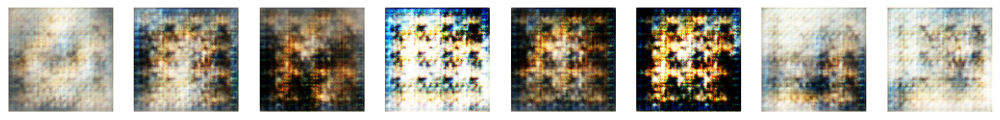

Epoch [   21/  100] | d_loss: 1.1501 | g_loss: 0.7000
Epoch [   22/  100] | d_loss: 1.3434 | g_loss: -2.1675
Epoch [   23/  100] | d_loss: 1.0830 | g_loss: -1.2601
Epoch [   24/  100] | d_loss: 1.0062 | g_loss: 3.0267
Epoch [   25/  100] | d_loss: 0.5167 | g_loss: 0.9991


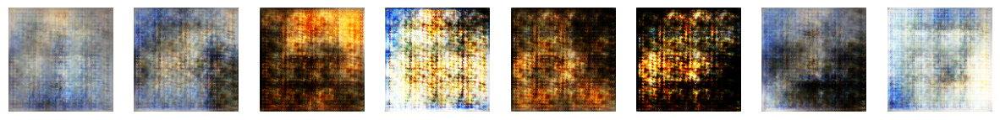

Epoch [   26/  100] | d_loss: 0.1612 | g_loss: 5.7640
Epoch [   27/  100] | d_loss: 0.2278 | g_loss: 0.2117
Epoch [   28/  100] | d_loss: 0.3718 | g_loss: 5.4383
Epoch [   29/  100] | d_loss: 1.4687 | g_loss: 5.4701
Epoch [   30/  100] | d_loss: 0.7440 | g_loss: 3.2417


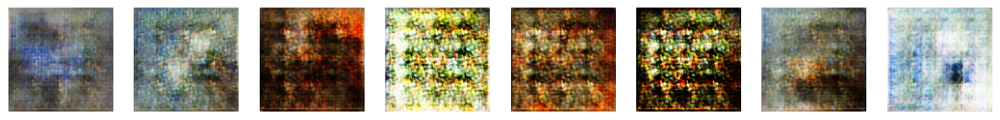

Epoch [   31/  100] | d_loss: 0.5456 | g_loss: 2.4960
Epoch [   32/  100] | d_loss: -0.0605 | g_loss: 9.7465
Epoch [   33/  100] | d_loss: 0.7048 | g_loss: 6.3469
Epoch [   34/  100] | d_loss: 0.8425 | g_loss: 2.4291
Epoch [   35/  100] | d_loss: -0.0259 | g_loss: 8.8468


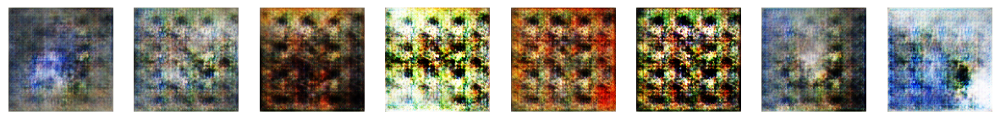

Epoch [   36/  100] | d_loss: -0.1794 | g_loss: 5.4163
Epoch [   37/  100] | d_loss: -0.5166 | g_loss: 7.2821
Epoch [   38/  100] | d_loss: -0.4276 | g_loss: 2.9664
Epoch [   39/  100] | d_loss: 0.4778 | g_loss: 3.3809
Epoch [   40/  100] | d_loss: 0.1585 | g_loss: 8.0653


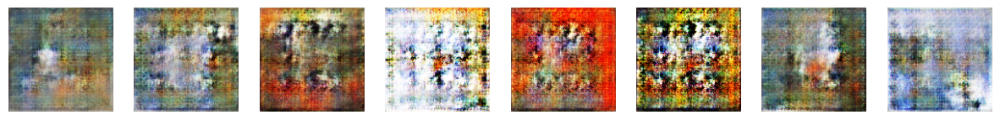

Epoch [   41/  100] | d_loss: -0.7285 | g_loss: 6.3364
Epoch [   42/  100] | d_loss: -0.8806 | g_loss: 13.1222
Epoch [   43/  100] | d_loss: -0.3978 | g_loss: 10.5556
Epoch [   44/  100] | d_loss: 1.2836 | g_loss: 5.9734
Epoch [   45/  100] | d_loss: -0.1085 | g_loss: 8.9432


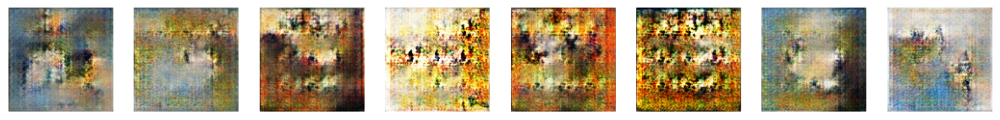

Epoch [   46/  100] | d_loss: -1.3950 | g_loss: 12.7905
Epoch [   47/  100] | d_loss: -1.2427 | g_loss: 5.6918
Epoch [   48/  100] | d_loss: 0.2030 | g_loss: 6.3079
Epoch [   49/  100] | d_loss: 0.6814 | g_loss: 5.9720
Epoch [   50/  100] | d_loss: 0.9946 | g_loss: 8.0193


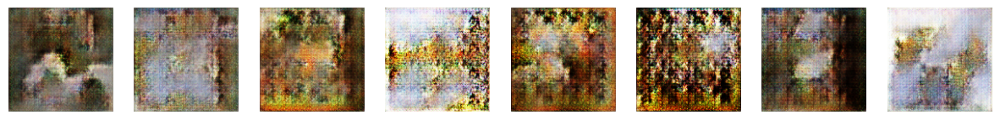

Epoch [   51/  100] | d_loss: -0.2428 | g_loss: 7.7060
Epoch [   52/  100] | d_loss: 0.0720 | g_loss: 20.8176
Epoch [   53/  100] | d_loss: 0.6397 | g_loss: 10.5606
Epoch [   54/  100] | d_loss: -1.2490 | g_loss: 7.4723
Epoch [   55/  100] | d_loss: -2.1069 | g_loss: 9.3289


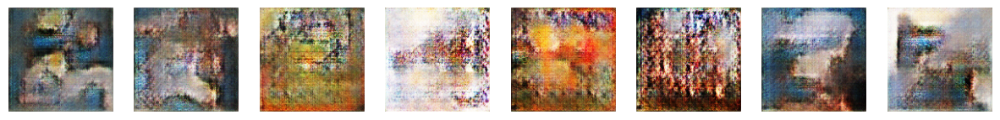

Epoch [   56/  100] | d_loss: -1.4086 | g_loss: 17.3685
Epoch [   57/  100] | d_loss: -2.0186 | g_loss: 12.9857
Epoch [   58/  100] | d_loss: -0.3280 | g_loss: 9.6582
Epoch [   59/  100] | d_loss: -0.0723 | g_loss: 9.4743
Epoch [   60/  100] | d_loss: -1.7793 | g_loss: 10.1442


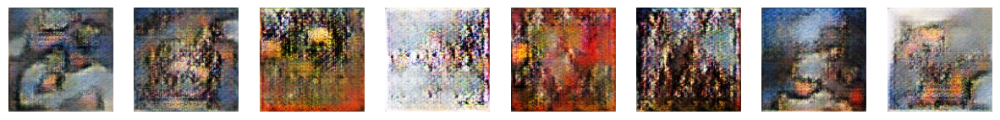

Epoch [   61/  100] | d_loss: -1.6174 | g_loss: 6.6194
Epoch [   62/  100] | d_loss: -1.9205 | g_loss: 11.2759
Epoch [   63/  100] | d_loss: -0.4785 | g_loss: 5.5978
Epoch [   64/  100] | d_loss: 1.4375 | g_loss: 16.9653
Epoch [   65/  100] | d_loss: -0.4224 | g_loss: 10.0003


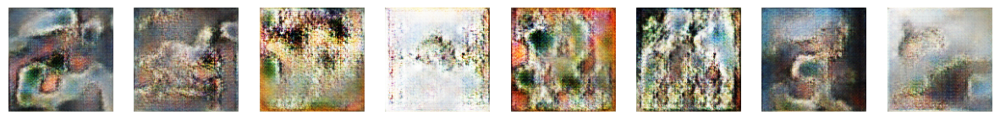

Epoch [   66/  100] | d_loss: -0.0743 | g_loss: 5.3638
Epoch [   67/  100] | d_loss: -0.6082 | g_loss: 15.9544
Epoch [   68/  100] | d_loss: -2.7966 | g_loss: 9.0144
Epoch [   69/  100] | d_loss: -0.7926 | g_loss: 13.4549
Epoch [   70/  100] | d_loss: -0.0569 | g_loss: 12.0923


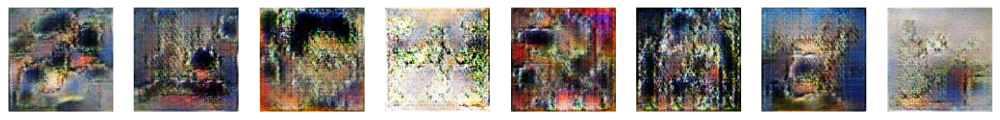

Epoch [   71/  100] | d_loss: -0.9604 | g_loss: 11.7572
Epoch [   72/  100] | d_loss: -2.1032 | g_loss: 2.4263
Epoch [   73/  100] | d_loss: -1.1551 | g_loss: 13.5009
Epoch [   74/  100] | d_loss: -1.9342 | g_loss: 9.3099
Epoch [   75/  100] | d_loss: -1.3716 | g_loss: 19.6045


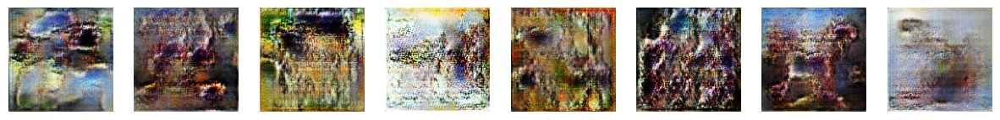

Epoch [   76/  100] | d_loss: -0.7109 | g_loss: 14.3459
Epoch [   77/  100] | d_loss: -1.3011 | g_loss: 16.7579
Epoch [   78/  100] | d_loss: -3.8645 | g_loss: 13.1791
Epoch [   79/  100] | d_loss: 3.8417 | g_loss: 12.1451
Epoch [   80/  100] | d_loss: -1.9578 | g_loss: 7.8398


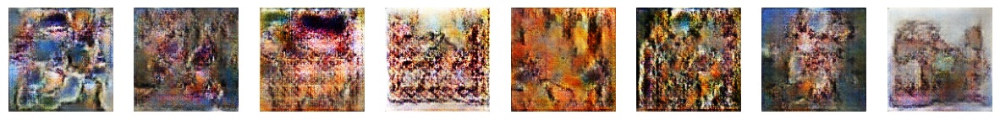

Epoch [   81/  100] | d_loss: -3.1174 | g_loss: 9.1446
Epoch [   82/  100] | d_loss: -0.5277 | g_loss: 12.5003
Epoch [   83/  100] | d_loss: -2.3596 | g_loss: 14.7305
Epoch [   84/  100] | d_loss: -1.3207 | g_loss: 13.9070
Epoch [   85/  100] | d_loss: -3.0658 | g_loss: 23.4554


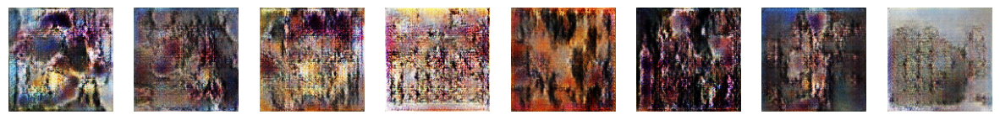

Epoch [   86/  100] | d_loss: -2.4674 | g_loss: 19.5022
Epoch [   87/  100] | d_loss: -0.8773 | g_loss: 13.1573
Epoch [   88/  100] | d_loss: -2.3155 | g_loss: 14.1929
Epoch [   89/  100] | d_loss: -2.1802 | g_loss: 18.2115
Epoch [   90/  100] | d_loss: -1.2484 | g_loss: 13.3868


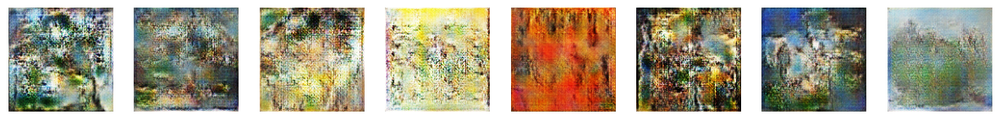

Epoch [   91/  100] | d_loss: -3.1823 | g_loss: 17.2510
Epoch [   92/  100] | d_loss: -0.9523 | g_loss: 12.5646
Epoch [   93/  100] | d_loss: -1.6466 | g_loss: 19.0901
Epoch [   94/  100] | d_loss: -1.8596 | g_loss: 18.6285
Epoch [   95/  100] | d_loss: -0.2633 | g_loss: 14.7182


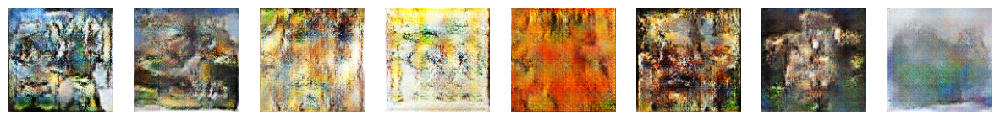

Epoch [   96/  100] | d_loss: -4.2794 | g_loss: 6.7952
Epoch [   97/  100] | d_loss: -1.6865 | g_loss: 11.3039
Epoch [   98/  100] | d_loss: 9.2527 | g_loss: 19.7298
Epoch [   99/  100] | d_loss: 0.5752 | g_loss: 20.6710
Epoch [  100/  100] | d_loss: -0.0656 | g_loss: 15.7461


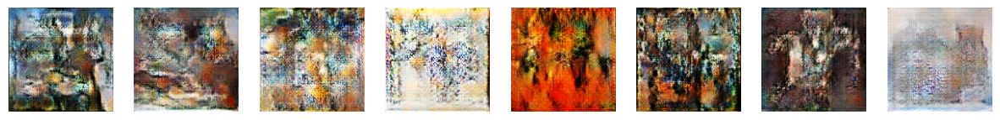

In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128

EPOCHS = 100
train(disc, gen, 
      EPOCHS, train_dataset, 
      d_optimizer, g_optimizer, 
      z_dim, 
      print_every=5)




In [ ]:
data_dir = 'resized'

In [ ]:
def train(D, G, n_epochs, dataloader, d_optimizer, g_optimizer, z_dim, print_every=5):
    sample_size = 8
    fixed_z = G.get_noise(n_samples=sample_size, z_dim=z_dim)
    for epoch in range(n_epochs):
        print(f'Epoch [{epoch+1}/{n_epochs}]')
        for batch_idx, (real_images, _) in enumerate(dataloader):
            batch_size = real_images.shape[0]

            # Train discriminator
            noise = tf.random.normal(shape=(batch_size, z_dim))
            fake_images = G(noise, training=True)

            with tf.GradientTape() as tape:
                real_output = D(real_images, training=True)
                fake_output = D(fake_images, training=True)

                d_loss_real = tf.reduce_mean(tf.math.squared_difference(real_output, 0.9))
                d_loss_fake = tf.reduce_mean(tf.square(fake_output))
                d_loss = 0.5 * (d_loss_real + d_loss_fake)

            d_gradients = tape.gradient(d_loss, D.trainable_variables)
            d_optimizer.apply_gradients(zip(d_gradients, D.trainable_variables))

            # Train generator
            noise = tf.random.normal(shape=(batch_size, z_dim))

            with tf.GradientTape() as tape:
                fake_images = G(noise, training=True)
                fake_output = D(fake_images, training=True)

                g_loss = 0.5 * tf.reduce_mean(tf.math.squared_difference(fake_output, 0.9))

            g_gradients = tape.gradient(g_loss, G.trainable_variables)
            g_optimizer.apply_gradients(zip(g_gradients, G.trainable_variables))

            

            if batch_idx % print_every == 0:
                print(f'Batch {batch_idx}: d_loss: {d_loss:.4f}, g_loss: {g_loss:.4f}')
        if (epoch % print_every == 0):
                G.trainable = False
                sample_image = G(fixed_z)
                print_tensor_images(sample_image)
                G.trainable = True


In [ ]:
# Model initialization
image_size = 128
z_dim = 150
gen = Generator(z_dim, in_chan=3, hidden_dim=64)
disc = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Optimizer initialization
g_optimizer = tf.keras.optimizers.RMSprop(learning_rate=lr_g)
d_optimizer = tf.keras.optimizers.RMSprop(learning_rate=lr)

train_dataset = get_dataloader_tf(batch_size, image_size, image_root)


Found 8683 files belonging to 1 classes.


Device is GPU
Epoch [1/100]
Batch 0: d_loss: 0.3866, g_loss: 0.9113
Batch 5: d_loss: 0.4747, g_loss: 0.5380
Batch 10: d_loss: 0.4135, g_loss: 0.7669
Batch 15: d_loss: 0.5469, g_loss: 0.0465
Batch 20: d_loss: 0.4848, g_loss: 0.9328
Batch 25: d_loss: 0.3792, g_loss: 0.0664
Batch 30: d_loss: 0.4091, g_loss: 0.7511
Batch 35: d_loss: 0.4186, g_loss: 0.0388
Batch 40: d_loss: 0.4233, g_loss: 1.0020
Batch 45: d_loss: 0.3283, g_loss: 0.0680
Batch 50: d_loss: 0.2527, g_loss: 0.7073
Batch 55: d_loss: 0.5416, g_loss: 0.0406
Batch 60: d_loss: 0.3781, g_loss: 1.1804
Batch 65: d_loss: 0.2663, g_loss: 0.1139


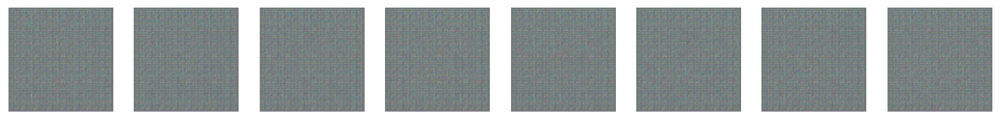

Epoch [2/100]
Batch 0: d_loss: 0.4350, g_loss: 1.5119
Batch 5: d_loss: 0.3676, g_loss: 0.0695
Batch 10: d_loss: 0.3557, g_loss: 1.1179
Batch 15: d_loss: 0.4226, g_loss: 0.5069
Batch 20: d_loss: 0.2398, g_loss: 0.1379
Batch 25: d_loss: 0.3657, g_loss: 0.7256
Batch 30: d_loss: 0.3026, g_loss: 0.0859
Batch 35: d_loss: 0.5193, g_loss: 0.1177
Batch 40: d_loss: 0.5301, g_loss: 0.3367
Batch 45: d_loss: 0.2432, g_loss: 0.3704
Batch 50: d_loss: 0.3256, g_loss: 0.1277
Batch 55: d_loss: 0.3481, g_loss: 0.2909
Batch 60: d_loss: 0.3952, g_loss: 0.0222
Batch 65: d_loss: 0.3021, g_loss: 0.2752
Epoch [3/100]
Batch 0: d_loss: 0.2262, g_loss: 0.1362
Batch 5: d_loss: 0.4108, g_loss: 0.1310
Batch 10: d_loss: 0.3428, g_loss: 0.2928
Batch 15: d_loss: 0.2840, g_loss: 0.1698
Batch 20: d_loss: 0.2914, g_loss: 0.2862
Batch 25: d_loss: 0.3757, g_loss: 0.1621
Batch 30: d_loss: 0.2966, g_loss: 0.3668
Batch 35: d_loss: 0.2564, g_loss: 0.1049
Batch 40: d_loss: 0.2682, g_loss: 0.3827
Batch 45: d_loss: 0.2807, g_loss:

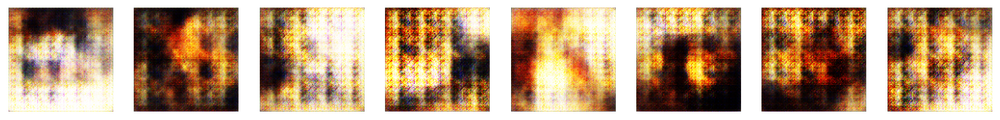

Epoch [7/100]
Batch 0: d_loss: 0.2757, g_loss: 0.2192
Batch 5: d_loss: 0.2428, g_loss: 0.1819
Batch 10: d_loss: 0.2457, g_loss: 0.1930
Batch 15: d_loss: 0.2697, g_loss: 0.0621
Batch 20: d_loss: 0.2083, g_loss: 0.1974
Batch 25: d_loss: 0.2987, g_loss: 0.1848
Batch 30: d_loss: 0.2277, g_loss: 0.0950
Batch 35: d_loss: 0.3845, g_loss: 0.3436
Batch 40: d_loss: 0.2066, g_loss: 0.2124
Batch 45: d_loss: 0.2287, g_loss: 0.2281
Batch 50: d_loss: 0.3456, g_loss: 0.0871
Batch 55: d_loss: 0.1935, g_loss: 0.1832
Batch 60: d_loss: 0.2074, g_loss: 0.0729
Batch 65: d_loss: 0.2351, g_loss: 0.2717
Epoch [8/100]
Batch 0: d_loss: 0.3289, g_loss: 0.1792
Batch 5: d_loss: 0.2188, g_loss: 0.3476
Batch 10: d_loss: 0.2386, g_loss: 0.0596
Batch 15: d_loss: 0.2260, g_loss: 0.3137
Batch 20: d_loss: 0.3198, g_loss: 0.1485
Batch 25: d_loss: 0.2297, g_loss: 0.1692
Batch 30: d_loss: 0.2037, g_loss: 0.1114
Batch 35: d_loss: 0.2870, g_loss: 0.2293
Batch 40: d_loss: 0.2289, g_loss: 0.2150
Batch 45: d_loss: 0.2148, g_loss:

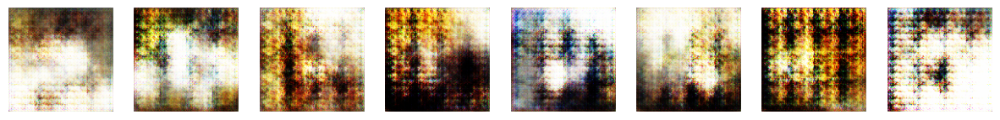

Epoch [12/100]
Batch 0: d_loss: 0.2231, g_loss: 0.1998
Batch 5: d_loss: 0.2699, g_loss: 0.0746
Batch 10: d_loss: 0.2947, g_loss: 0.3187
Batch 15: d_loss: 0.2716, g_loss: 0.0635
Batch 20: d_loss: 0.2037, g_loss: 0.2078
Batch 25: d_loss: 0.1868, g_loss: 0.1813
Batch 30: d_loss: 0.2683, g_loss: 0.1212
Batch 35: d_loss: 0.2064, g_loss: 0.1985
Batch 40: d_loss: 0.2028, g_loss: 0.0698
Batch 45: d_loss: 0.1671, g_loss: 0.2144
Batch 50: d_loss: 0.3174, g_loss: 0.1240
Batch 55: d_loss: 0.2154, g_loss: 0.3679
Batch 60: d_loss: 0.3417, g_loss: 0.0669
Batch 65: d_loss: 0.1835, g_loss: 0.2827
Epoch [13/100]
Batch 0: d_loss: 0.2178, g_loss: 0.1010
Batch 5: d_loss: 0.1819, g_loss: 0.1964
Batch 10: d_loss: 0.2807, g_loss: 0.4479
Batch 15: d_loss: 0.1998, g_loss: 0.1637
Batch 20: d_loss: 0.1927, g_loss: 0.2075
Batch 25: d_loss: 0.3438, g_loss: 0.0686
Batch 30: d_loss: 0.2058, g_loss: 0.1299
Batch 35: d_loss: 0.2168, g_loss: 0.3605
Batch 40: d_loss: 0.1920, g_loss: 0.0989
Batch 45: d_loss: 0.2926, g_los

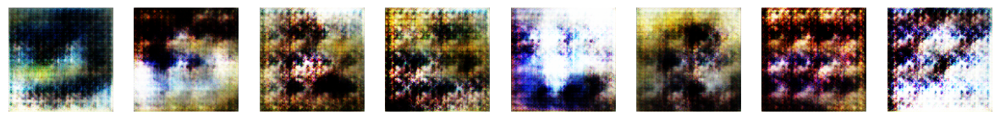

Epoch [17/100]
Batch 0: d_loss: 0.1799, g_loss: 0.2548
Batch 5: d_loss: 0.1814, g_loss: 0.0925
Batch 10: d_loss: 0.2030, g_loss: 0.2072
Batch 15: d_loss: 0.2228, g_loss: 0.3213
Batch 20: d_loss: 0.2597, g_loss: 0.1318
Batch 25: d_loss: 0.2101, g_loss: 0.2518
Batch 30: d_loss: 0.2237, g_loss: 0.1074
Batch 35: d_loss: 0.1999, g_loss: 0.1994
Batch 40: d_loss: 0.2378, g_loss: 0.2804
Batch 45: d_loss: 0.2416, g_loss: 0.0619
Batch 50: d_loss: 0.1654, g_loss: 0.2434
Batch 55: d_loss: 0.1951, g_loss: 0.1149
Batch 60: d_loss: 0.2986, g_loss: 0.4775
Batch 65: d_loss: 0.1641, g_loss: 0.1969
Epoch [18/100]
Batch 0: d_loss: 0.2015, g_loss: 0.1302
Batch 5: d_loss: 0.2825, g_loss: 0.1255
Batch 10: d_loss: 0.2084, g_loss: 0.2350
Batch 15: d_loss: 0.2088, g_loss: 0.2448
Batch 20: d_loss: 0.1921, g_loss: 0.1053
Batch 25: d_loss: 0.2223, g_loss: 0.1954
Batch 30: d_loss: 0.2369, g_loss: 0.1179
Batch 35: d_loss: 0.1762, g_loss: 0.1524
Batch 40: d_loss: 0.2339, g_loss: 0.2071
Batch 45: d_loss: 0.2138, g_los

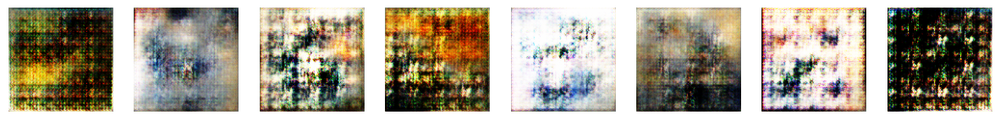

Epoch [22/100]
Batch 0: d_loss: 0.2060, g_loss: 0.1776
Batch 5: d_loss: 0.1988, g_loss: 0.2614
Batch 10: d_loss: 0.2284, g_loss: 0.1343
Batch 15: d_loss: 0.1650, g_loss: 0.2757
Batch 20: d_loss: 0.2116, g_loss: 0.1279
Batch 25: d_loss: 0.2300, g_loss: 0.1845
Batch 30: d_loss: 0.3281, g_loss: 0.5416
Batch 35: d_loss: 0.1736, g_loss: 0.2372
Batch 40: d_loss: 0.2441, g_loss: 0.3611
Batch 45: d_loss: 0.2259, g_loss: 0.1349
Batch 50: d_loss: 0.2311, g_loss: 0.3111
Batch 55: d_loss: 0.1967, g_loss: 0.1279
Batch 60: d_loss: 0.2057, g_loss: 0.1871
Batch 65: d_loss: 0.1896, g_loss: 0.2697
Epoch [23/100]
Batch 0: d_loss: 0.1835, g_loss: 0.1310
Batch 5: d_loss: 0.1946, g_loss: 0.1898
Batch 10: d_loss: 0.1852, g_loss: 0.3171
Batch 15: d_loss: 0.2145, g_loss: 0.1232
Batch 20: d_loss: 0.2849, g_loss: 0.3890
Batch 25: d_loss: 0.1884, g_loss: 0.1904
Batch 30: d_loss: 0.2600, g_loss: 0.0911
Batch 35: d_loss: 0.2169, g_loss: 0.2703
Batch 40: d_loss: 0.2008, g_loss: 0.1898
Batch 45: d_loss: 0.2327, g_los

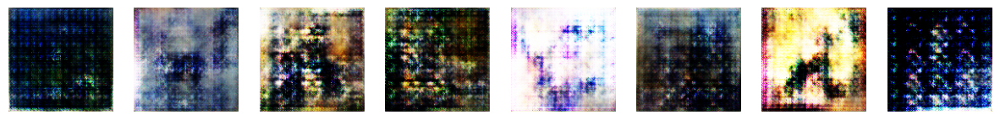

Epoch [27/100]
Batch 0: d_loss: 0.2027, g_loss: 0.3466
Batch 5: d_loss: 0.1596, g_loss: 0.0875
Batch 10: d_loss: 0.2388, g_loss: 0.1983
Batch 15: d_loss: 0.2222, g_loss: 0.0966
Batch 20: d_loss: 0.2167, g_loss: 0.3169
Batch 25: d_loss: 0.1793, g_loss: 0.1426
Batch 30: d_loss: 0.2574, g_loss: 0.4014
Batch 35: d_loss: 0.1729, g_loss: 0.1894
Batch 40: d_loss: 0.1509, g_loss: 0.1885
Batch 45: d_loss: 0.2310, g_loss: 0.3511
Batch 50: d_loss: 0.1928, g_loss: 0.1430
Batch 55: d_loss: 0.1851, g_loss: 0.3710
Batch 60: d_loss: 0.2367, g_loss: 0.1714
Batch 65: d_loss: 0.2279, g_loss: 0.1509
Epoch [28/100]
Batch 0: d_loss: 0.1283, g_loss: 0.1831
Batch 5: d_loss: 0.2058, g_loss: 0.5435
Batch 10: d_loss: 0.2130, g_loss: 0.2910
Batch 15: d_loss: 0.1514, g_loss: 0.1366
Batch 20: d_loss: 0.2361, g_loss: 0.2343
Batch 25: d_loss: 0.1712, g_loss: 0.1776
Batch 30: d_loss: 0.1864, g_loss: 0.1390
Batch 35: d_loss: 0.2144, g_loss: 0.1074
Batch 40: d_loss: 0.1866, g_loss: 0.4353
Batch 45: d_loss: 0.2341, g_los

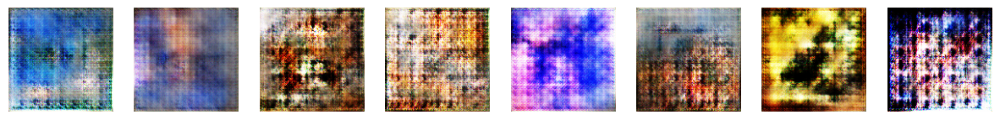

Epoch [32/100]
Batch 0: d_loss: 0.1474, g_loss: 0.2288
Batch 5: d_loss: 0.1667, g_loss: 0.1144
Batch 10: d_loss: 0.1431, g_loss: 0.2608
Batch 15: d_loss: 0.4270, g_loss: 0.1813
Batch 20: d_loss: 0.1699, g_loss: 0.1961
Batch 25: d_loss: 0.2061, g_loss: 0.4881
Batch 30: d_loss: 0.1486, g_loss: 0.1137
Batch 35: d_loss: 0.2035, g_loss: 0.2645
Batch 40: d_loss: 0.1985, g_loss: 0.1068
Batch 45: d_loss: 0.2014, g_loss: 0.3495
Batch 50: d_loss: 0.1275, g_loss: 0.1273
Batch 55: d_loss: 0.1640, g_loss: 0.3224
Batch 60: d_loss: 0.1744, g_loss: 0.0861
Batch 65: d_loss: 0.1374, g_loss: 0.2068
Epoch [33/100]
Batch 0: d_loss: 0.2025, g_loss: 0.1509
Batch 5: d_loss: 0.1815, g_loss: 0.2921
Batch 10: d_loss: 0.1559, g_loss: 0.2819
Batch 15: d_loss: 0.2211, g_loss: 0.1104
Batch 20: d_loss: 0.2145, g_loss: 0.4977
Batch 25: d_loss: 0.1620, g_loss: 0.3793
Batch 30: d_loss: 0.2075, g_loss: 0.7573
Batch 35: d_loss: 0.1013, g_loss: 0.2879
Batch 40: d_loss: 0.1848, g_loss: 0.5110
Batch 45: d_loss: 0.1362, g_los

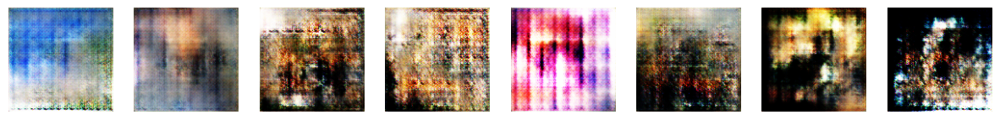

Epoch [37/100]
Batch 0: d_loss: 0.1681, g_loss: 0.2212
Batch 5: d_loss: 0.2624, g_loss: 0.6772
Batch 10: d_loss: 0.1214, g_loss: 0.1517
Batch 15: d_loss: 0.2297, g_loss: 0.4587
Batch 20: d_loss: 0.1363, g_loss: 0.2648
Batch 25: d_loss: 0.1853, g_loss: 0.4866
Batch 30: d_loss: 0.1637, g_loss: 0.1572
Batch 35: d_loss: 0.1975, g_loss: 0.2640
Batch 40: d_loss: 0.2464, g_loss: 0.0911
Batch 45: d_loss: 0.1656, g_loss: 0.4266
Batch 50: d_loss: 0.1295, g_loss: 0.1358
Batch 55: d_loss: 0.2189, g_loss: 0.3436
Batch 60: d_loss: 0.1617, g_loss: 0.3995
Batch 65: d_loss: 0.2124, g_loss: 0.1132
Epoch [38/100]
Batch 0: d_loss: 0.1702, g_loss: 0.4137
Batch 5: d_loss: 0.1316, g_loss: 0.1248
Batch 10: d_loss: 0.1337, g_loss: 0.2274
Batch 15: d_loss: 0.1890, g_loss: 0.3290
Batch 20: d_loss: 0.1211, g_loss: 0.1595
Batch 25: d_loss: 0.1423, g_loss: 0.3538
Batch 30: d_loss: 0.3055, g_loss: 0.1504
Batch 35: d_loss: 0.1486, g_loss: 0.1901
Batch 40: d_loss: 0.1355, g_loss: 0.3482
Batch 45: d_loss: 0.1455, g_los

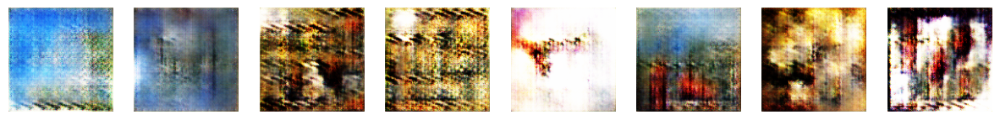

Epoch [42/100]
Batch 0: d_loss: 0.0987, g_loss: 0.4640
Batch 5: d_loss: 0.2261, g_loss: 0.1507
Batch 10: d_loss: 0.1490, g_loss: 0.3020
Batch 15: d_loss: 0.1894, g_loss: 0.1004
Batch 20: d_loss: 0.1816, g_loss: 0.3076
Batch 25: d_loss: 0.1221, g_loss: 0.1817
Batch 30: d_loss: 0.2022, g_loss: 0.6339
Batch 35: d_loss: 0.1347, g_loss: 0.2865
Batch 40: d_loss: 0.1964, g_loss: 0.1302
Batch 45: d_loss: 0.1433, g_loss: 0.3287
Batch 50: d_loss: 0.1231, g_loss: 0.1462
Batch 55: d_loss: 0.1765, g_loss: 0.5075
Batch 60: d_loss: 0.1977, g_loss: 0.1236
Batch 65: d_loss: 0.2551, g_loss: 0.2901
Epoch [43/100]
Batch 0: d_loss: 0.1409, g_loss: 0.2180
Batch 5: d_loss: 0.1586, g_loss: 0.4918
Batch 10: d_loss: 0.2314, g_loss: 0.1339
Batch 15: d_loss: 0.0981, g_loss: 0.3533
Batch 20: d_loss: 0.1644, g_loss: 0.1557
Batch 25: d_loss: 0.1973, g_loss: 0.4991
Batch 30: d_loss: 0.1647, g_loss: 0.1621
Batch 35: d_loss: 0.1741, g_loss: 0.2471
Batch 40: d_loss: 0.1347, g_loss: 0.3018
Batch 45: d_loss: 0.1969, g_los

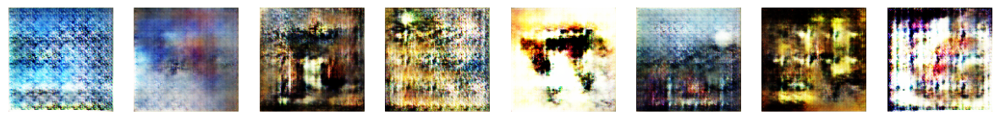

Epoch [47/100]
Batch 0: d_loss: 0.2076, g_loss: 0.1164
Batch 5: d_loss: 0.1297, g_loss: 0.3364
Batch 10: d_loss: 0.4119, g_loss: 0.1153
Batch 15: d_loss: 0.1707, g_loss: 0.3160
Batch 20: d_loss: 0.1732, g_loss: 0.0849
Batch 25: d_loss: 0.1067, g_loss: 0.3290
Batch 30: d_loss: 0.2971, g_loss: 0.5216
Batch 35: d_loss: 0.1487, g_loss: 0.2028
Batch 40: d_loss: 0.1358, g_loss: 0.2442
Batch 45: d_loss: 0.1526, g_loss: 0.3252
Batch 50: d_loss: 0.3710, g_loss: 0.1952
Batch 55: d_loss: 0.0979, g_loss: 0.2402
Batch 60: d_loss: 0.3789, g_loss: 0.0315
Batch 65: d_loss: 0.1307, g_loss: 0.1488
Epoch [48/100]
Batch 0: d_loss: 0.1728, g_loss: 0.3154
Batch 5: d_loss: 0.1063, g_loss: 0.0711
Batch 10: d_loss: 0.1574, g_loss: 0.2863
Batch 15: d_loss: 0.1434, g_loss: 0.2400
Batch 20: d_loss: 0.2041, g_loss: 0.3345
Batch 25: d_loss: 0.1460, g_loss: 0.1307
Batch 30: d_loss: 0.1657, g_loss: 0.3959
Batch 35: d_loss: 0.1846, g_loss: 0.1111
Batch 40: d_loss: 0.2153, g_loss: 0.3334
Batch 45: d_loss: 0.2176, g_los

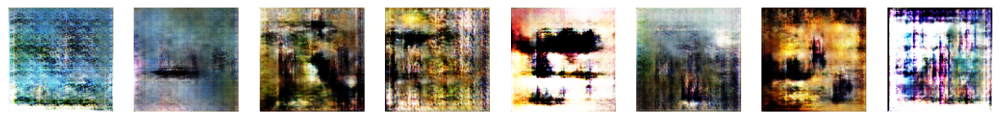

Epoch [52/100]
Batch 0: d_loss: 0.1750, g_loss: 0.2384
Batch 5: d_loss: 0.1742, g_loss: 0.3901
Batch 10: d_loss: 0.1569, g_loss: 0.1336
Batch 15: d_loss: 0.0994, g_loss: 0.2665
Batch 20: d_loss: 0.2326, g_loss: 0.1036
Batch 25: d_loss: 0.2325, g_loss: 0.4786
Batch 30: d_loss: 0.1492, g_loss: 0.1087
Batch 35: d_loss: 0.1035, g_loss: 0.2699
Batch 40: d_loss: 0.1654, g_loss: 0.6726
Batch 45: d_loss: 0.1442, g_loss: 0.0894
Batch 50: d_loss: 0.1404, g_loss: 0.5269
Batch 55: d_loss: 0.1738, g_loss: 0.2081
Batch 60: d_loss: 0.2394, g_loss: 0.8198
Batch 65: d_loss: 0.0975, g_loss: 0.2234
Epoch [53/100]
Batch 0: d_loss: 0.1511, g_loss: 0.1705
Batch 5: d_loss: 0.2062, g_loss: 0.5232
Batch 10: d_loss: 0.0968, g_loss: 0.1803
Batch 15: d_loss: 0.1215, g_loss: 0.4223
Batch 20: d_loss: 0.2549, g_loss: 0.1029
Batch 25: d_loss: 0.1034, g_loss: 0.3504
Batch 30: d_loss: 0.2873, g_loss: 0.0554
Batch 35: d_loss: 0.1049, g_loss: 0.2411
Batch 40: d_loss: 0.1764, g_loss: 0.5566
Batch 45: d_loss: 0.1319, g_los

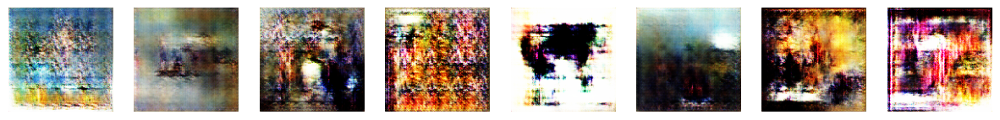

Epoch [57/100]
Batch 0: d_loss: 0.2419, g_loss: 0.5238
Batch 5: d_loss: 0.1268, g_loss: 0.2110
Batch 10: d_loss: 0.1123, g_loss: 0.2992
Batch 15: d_loss: 0.2535, g_loss: 0.1446
Batch 20: d_loss: 0.0788, g_loss: 0.3572
Batch 25: d_loss: 0.3296, g_loss: 0.1773
Batch 30: d_loss: 0.1244, g_loss: 0.2371
Batch 35: d_loss: 0.1416, g_loss: 0.3263
Batch 40: d_loss: 0.1328, g_loss: 0.3603
Batch 45: d_loss: 0.3264, g_loss: 0.1049
Batch 50: d_loss: 0.1051, g_loss: 0.1758
Batch 55: d_loss: 0.1788, g_loss: 0.3760
Batch 60: d_loss: 0.1281, g_loss: 0.4003
Batch 65: d_loss: 0.2790, g_loss: 0.1587
Epoch [58/100]
Batch 0: d_loss: 0.1173, g_loss: 0.1703
Batch 5: d_loss: 0.1928, g_loss: 0.1113
Batch 10: d_loss: 0.1270, g_loss: 0.4040
Batch 15: d_loss: 0.1953, g_loss: 0.1160
Batch 20: d_loss: 0.1281, g_loss: 0.4043
Batch 25: d_loss: 0.2083, g_loss: 0.1290
Batch 30: d_loss: 0.1339, g_loss: 0.1384
Batch 35: d_loss: 0.1961, g_loss: 0.3685
Batch 40: d_loss: 0.2064, g_loss: 0.1302
Batch 45: d_loss: 0.1534, g_los

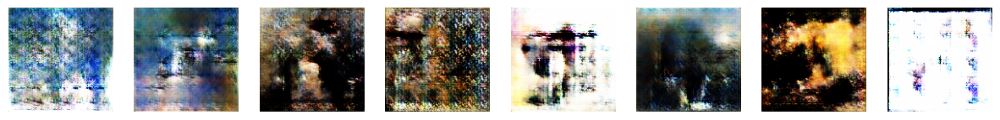

Epoch [62/100]
Batch 0: d_loss: 0.1689, g_loss: 0.1354
Batch 5: d_loss: 0.1400, g_loss: 0.2673
Batch 10: d_loss: 0.1210, g_loss: 0.2397
Batch 15: d_loss: 0.1625, g_loss: 0.2484
Batch 20: d_loss: 0.0976, g_loss: 0.4083
Batch 25: d_loss: 0.2386, g_loss: 0.0706
Batch 30: d_loss: 0.0770, g_loss: 0.2538
Batch 35: d_loss: 0.2098, g_loss: 0.0496
Batch 40: d_loss: 0.0954, g_loss: 0.2261
Batch 45: d_loss: 0.1897, g_loss: 0.9133
Batch 50: d_loss: 0.1096, g_loss: 0.2816
Batch 55: d_loss: 0.1681, g_loss: 0.6597
Batch 60: d_loss: 0.1266, g_loss: 0.1398
Batch 65: d_loss: 0.1659, g_loss: 0.5874
Epoch [63/100]
Batch 0: d_loss: 0.1558, g_loss: 0.1573
Batch 5: d_loss: 0.2712, g_loss: 0.5351
Batch 10: d_loss: 0.1706, g_loss: 0.2895
Batch 15: d_loss: 0.2351, g_loss: 0.4983
Batch 20: d_loss: 0.1419, g_loss: 0.1714
Batch 25: d_loss: 0.1788, g_loss: 0.4054
Batch 30: d_loss: 0.1239, g_loss: 0.2068
Batch 35: d_loss: 0.2300, g_loss: 0.7239
Batch 40: d_loss: 0.1268, g_loss: 0.2676
Batch 45: d_loss: 0.1939, g_los

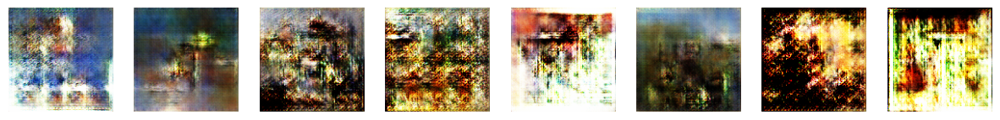

Epoch [67/100]
Batch 0: d_loss: 0.0922, g_loss: 0.1763
Batch 5: d_loss: 0.1349, g_loss: 0.3441
Batch 10: d_loss: 0.2251, g_loss: 0.0808
Batch 15: d_loss: 0.1328, g_loss: 0.3870
Batch 20: d_loss: 0.2924, g_loss: 0.1294
Batch 25: d_loss: 0.1184, g_loss: 0.4030
Batch 30: d_loss: 0.1514, g_loss: 0.1962
Batch 35: d_loss: 0.1438, g_loss: 0.4854
Batch 40: d_loss: 0.1076, g_loss: 0.1918
Batch 45: d_loss: 0.1165, g_loss: 0.4055
Batch 50: d_loss: 0.1151, g_loss: 0.5882
Batch 55: d_loss: 0.1329, g_loss: 0.1996
Batch 60: d_loss: 0.1648, g_loss: 0.1325
Batch 65: d_loss: 0.1841, g_loss: 0.2650
Epoch [68/100]
Batch 0: d_loss: 0.1134, g_loss: 0.2256
Batch 5: d_loss: 0.1429, g_loss: 0.5868
Batch 10: d_loss: 0.1614, g_loss: 0.1436
Batch 15: d_loss: 0.1499, g_loss: 0.4366
Batch 20: d_loss: 0.1668, g_loss: 0.1258
Batch 25: d_loss: 0.1699, g_loss: 0.4815
Batch 30: d_loss: 0.0689, g_loss: 0.3211
Batch 35: d_loss: 0.2095, g_loss: 0.1112
Batch 40: d_loss: 0.1585, g_loss: 0.3464
Batch 45: d_loss: 0.2987, g_los

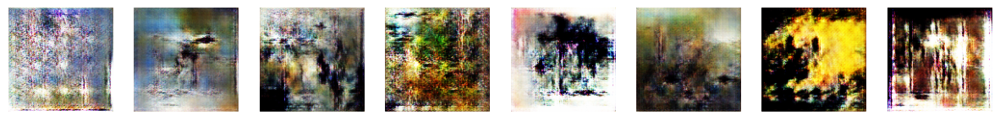

Epoch [72/100]
Batch 0: d_loss: 0.1365, g_loss: 0.4543
Batch 5: d_loss: 0.1303, g_loss: 0.1975
Batch 10: d_loss: 0.1401, g_loss: 0.4325
Batch 15: d_loss: 0.1219, g_loss: 0.2393
Batch 20: d_loss: 0.1655, g_loss: 0.3731
Batch 25: d_loss: 0.0815, g_loss: 0.2511
Batch 30: d_loss: 0.1053, g_loss: 0.2582
Batch 35: d_loss: 0.1158, g_loss: 0.1721
Batch 40: d_loss: 0.0979, g_loss: 0.4619
Batch 45: d_loss: 0.1921, g_loss: 0.1719
Batch 50: d_loss: 0.1446, g_loss: 0.2700
Batch 55: d_loss: 0.2468, g_loss: 0.7956
Batch 60: d_loss: 0.1304, g_loss: 0.1793
Batch 65: d_loss: 0.1913, g_loss: 0.7527
Epoch [73/100]
Batch 0: d_loss: 0.1545, g_loss: 0.1645
Batch 5: d_loss: 0.1164, g_loss: 0.5057
Batch 10: d_loss: 0.0901, g_loss: 0.1918
Batch 15: d_loss: 0.1146, g_loss: 0.3586
Batch 20: d_loss: 0.1313, g_loss: 0.1380
Batch 25: d_loss: 0.1384, g_loss: 0.4402
Batch 30: d_loss: 0.1710, g_loss: 0.0881
Batch 35: d_loss: 0.0977, g_loss: 0.2498
Batch 40: d_loss: 0.1356, g_loss: 0.1066
Batch 45: d_loss: 0.1043, g_los

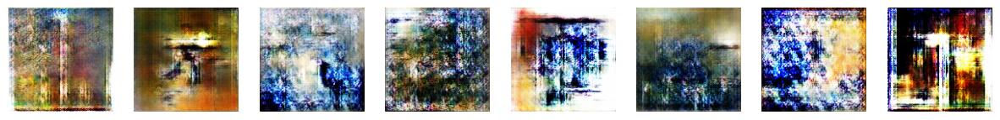

Epoch [77/100]
Batch 0: d_loss: 0.0696, g_loss: 0.2101
Batch 5: d_loss: 0.0827, g_loss: 0.3508
Batch 10: d_loss: 0.0953, g_loss: 0.2132
Batch 15: d_loss: 0.1121, g_loss: 0.2576
Batch 20: d_loss: 0.0896, g_loss: 0.2072
Batch 25: d_loss: 0.1754, g_loss: 0.5851
Batch 30: d_loss: 0.1337, g_loss: 0.0763
Batch 35: d_loss: 0.1720, g_loss: 0.4856
Batch 40: d_loss: 0.1434, g_loss: 0.1700
Batch 45: d_loss: 0.1488, g_loss: 0.5318
Batch 50: d_loss: 0.1124, g_loss: 0.1947
Batch 55: d_loss: 0.0769, g_loss: 0.3901
Batch 60: d_loss: 0.0833, g_loss: 0.1856
Batch 65: d_loss: 0.1662, g_loss: 0.6253
Epoch [78/100]
Batch 0: d_loss: 0.0785, g_loss: 0.1977
Batch 5: d_loss: 0.2451, g_loss: 0.7121
Batch 10: d_loss: 0.1143, g_loss: 0.2342
Batch 15: d_loss: 0.1040, g_loss: 0.3103
Batch 20: d_loss: 0.0725, g_loss: 0.1855
Batch 25: d_loss: 0.1376, g_loss: 0.2774
Batch 30: d_loss: 0.1002, g_loss: 0.4839
Batch 35: d_loss: 0.1138, g_loss: 0.1717
Batch 40: d_loss: 0.1362, g_loss: 0.3585
Batch 45: d_loss: 0.2428, g_los

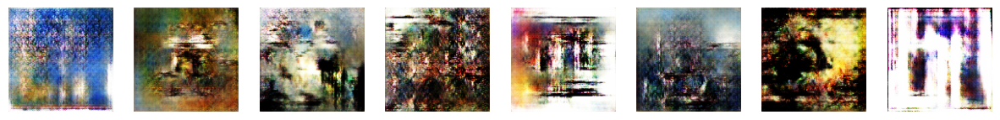

Epoch [82/100]
Batch 0: d_loss: 0.1479, g_loss: 0.4054
Batch 5: d_loss: 0.1515, g_loss: 0.1567
Batch 10: d_loss: 0.1329, g_loss: 0.3355
Batch 15: d_loss: 0.2388, g_loss: 0.0692
Batch 20: d_loss: 0.1021, g_loss: 0.3225
Batch 25: d_loss: 0.2772, g_loss: 0.5859
Batch 30: d_loss: 0.1272, g_loss: 0.2388
Batch 35: d_loss: 0.1066, g_loss: 0.3295
Batch 40: d_loss: 0.1929, g_loss: 0.6658
Batch 45: d_loss: 0.1856, g_loss: 0.0771
Batch 50: d_loss: 0.1195, g_loss: 0.3997
Batch 55: d_loss: 0.1244, g_loss: 0.1973
Batch 60: d_loss: 0.2230, g_loss: 0.0720
Batch 65: d_loss: 0.0887, g_loss: 0.3001
Epoch [83/100]
Batch 0: d_loss: 0.0857, g_loss: 0.3610
Batch 5: d_loss: 0.2983, g_loss: 0.4927
Batch 10: d_loss: 0.1287, g_loss: 0.3105
Batch 15: d_loss: 0.1008, g_loss: 0.4222
Batch 20: d_loss: 0.0904, g_loss: 0.1855
Batch 25: d_loss: 0.1125, g_loss: 0.4591
Batch 30: d_loss: 0.1749, g_loss: 0.1397
Batch 35: d_loss: 0.1870, g_loss: 0.3523
Batch 40: d_loss: 0.0879, g_loss: 0.3571
Batch 45: d_loss: 0.0851, g_los

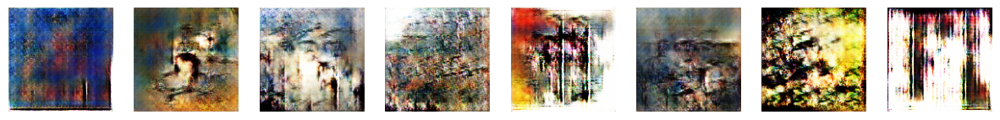

Epoch [87/100]
Batch 0: d_loss: 0.1460, g_loss: 0.3628
Batch 5: d_loss: 0.0795, g_loss: 0.3604
Batch 10: d_loss: 0.2988, g_loss: 0.6767
Batch 15: d_loss: 0.1014, g_loss: 0.2413
Batch 20: d_loss: 0.1160, g_loss: 0.4378
Batch 25: d_loss: 0.0931, g_loss: 0.7436
Batch 30: d_loss: 0.0895, g_loss: 0.2268
Batch 35: d_loss: 0.1060, g_loss: 0.4210
Batch 40: d_loss: 0.3008, g_loss: 0.0369
Batch 45: d_loss: 0.1150, g_loss: 0.2661
Batch 50: d_loss: 0.1750, g_loss: 0.7440
Batch 55: d_loss: 0.1113, g_loss: 0.1191
Batch 60: d_loss: 0.1326, g_loss: 0.2986
Batch 65: d_loss: 0.2504, g_loss: 0.7271
Epoch [88/100]
Batch 0: d_loss: 0.1660, g_loss: 0.2067
Batch 5: d_loss: 0.1556, g_loss: 0.4982
Batch 10: d_loss: 0.1345, g_loss: 0.1291
Batch 15: d_loss: 0.1542, g_loss: 0.5856
Batch 20: d_loss: 0.1177, g_loss: 0.1430
Batch 25: d_loss: 0.2013, g_loss: 0.4761
Batch 30: d_loss: 0.0794, g_loss: 0.2563
Batch 35: d_loss: 0.1311, g_loss: 0.6474
Batch 40: d_loss: 0.0981, g_loss: 0.3032
Batch 45: d_loss: 0.0653, g_los

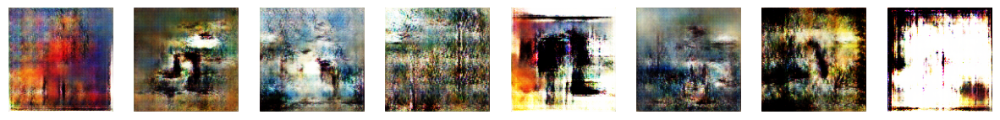

Epoch [92/100]
Batch 0: d_loss: 0.2048, g_loss: 0.1686
Batch 5: d_loss: 0.0800, g_loss: 0.4248
Batch 10: d_loss: 0.1038, g_loss: 0.1869
Batch 15: d_loss: 0.1327, g_loss: 0.4528
Batch 20: d_loss: 0.0789, g_loss: 0.3288
Batch 25: d_loss: 0.2415, g_loss: 0.0587
Batch 30: d_loss: 0.1166, g_loss: 0.2293
Batch 35: d_loss: 0.2184, g_loss: 0.5565
Batch 40: d_loss: 0.0613, g_loss: 0.2521
Batch 45: d_loss: 0.1249, g_loss: 0.0812
Batch 50: d_loss: 0.1303, g_loss: 0.2547
Batch 55: d_loss: 0.0569, g_loss: 0.2256
Batch 60: d_loss: 0.1614, g_loss: 0.3984
Batch 65: d_loss: 0.0820, g_loss: 0.2398
Epoch [93/100]
Batch 0: d_loss: 0.1022, g_loss: 0.4498
Batch 5: d_loss: 0.1030, g_loss: 0.2005
Batch 10: d_loss: 0.1779, g_loss: 0.5524
Batch 15: d_loss: 0.0950, g_loss: 0.2666
Batch 20: d_loss: 0.1530, g_loss: 0.4966
Batch 25: d_loss: 0.1319, g_loss: 0.1672
Batch 30: d_loss: 0.1179, g_loss: 0.4935
Batch 35: d_loss: 0.1928, g_loss: 0.1477
Batch 40: d_loss: 0.0959, g_loss: 0.3219
Batch 45: d_loss: 0.2511, g_los

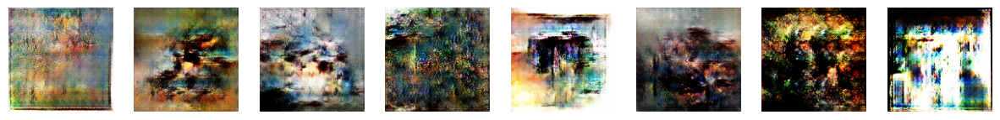

Epoch [97/100]
Batch 0: d_loss: 0.1077, g_loss: 0.0938
Batch 5: d_loss: 0.1616, g_loss: 0.4328
Batch 10: d_loss: 0.1417, g_loss: 0.1536
Batch 15: d_loss: 0.2074, g_loss: 0.5265
Batch 20: d_loss: 0.0456, g_loss: 0.3683
Batch 25: d_loss: 0.1234, g_loss: 0.1776
Batch 30: d_loss: 0.1825, g_loss: 0.6651
Batch 35: d_loss: 0.1320, g_loss: 0.2932
Batch 40: d_loss: 0.1478, g_loss: 0.4596
Batch 45: d_loss: 0.0918, g_loss: 0.2224
Batch 50: d_loss: 0.1936, g_loss: 0.1166
Batch 55: d_loss: 0.1107, g_loss: 0.2883
Batch 60: d_loss: 0.2012, g_loss: 0.5659
Batch 65: d_loss: 0.0711, g_loss: 0.4036
Epoch [98/100]
Batch 0: d_loss: 0.1006, g_loss: 0.1637
Batch 5: d_loss: 0.1029, g_loss: 0.3767
Batch 10: d_loss: 0.1181, g_loss: 0.4928
Batch 15: d_loss: 0.1965, g_loss: 0.1655
Batch 20: d_loss: 0.0957, g_loss: 0.3379
Batch 25: d_loss: 0.1350, g_loss: 0.5445
Batch 30: d_loss: 0.1034, g_loss: 0.1945
Batch 35: d_loss: 0.1627, g_loss: 0.6164
Batch 40: d_loss: 0.1731, g_loss: 0.1409
Batch 45: d_loss: 0.0923, g_los

In [ ]:
import tensorflow as tf

# Hyperparameters
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)

z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 150
lr = 0.0002
lr_g = 0.0004
batch_size = 128
image_size = 128

EPOCHS = 100
train(disc, gen, 
      EPOCHS, train_dataset, 
      d_optimizer, g_optimizer, 
      z_dim, 
      print_every=5)




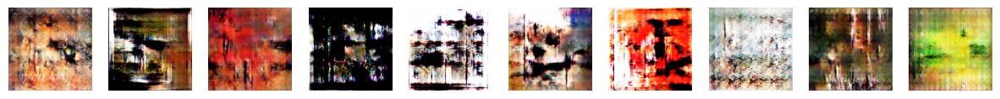

In [ ]:
def generate_random_images(generator, num_images, z_dim):
    noise = generator.get_noise(num_images, z_dim)
    generated_images = generator(noise, training=False)
    return generated_images

num_images = 10
z_dim = 150  # This is the noise dimension you have defined earlier

generated_images = generate_random_images(gen, num_images, z_dim)
print_tensor_images(generated_images)


In [ ]:
!kaggle datasets download -d arnaud58/landscape-pictures

100% 620M/620M [00:29<00:00, 21.6MB/s]
100% 620M/620M [00:29<00:00, 21.7MB/s]


In [ ]:
import os
import shutil


source_folder = os.getcwd()
destination_folder = os.path.join(source_folder, 'landscape')


if not os.path.exists(destination_folder):
    os.makedirs(destination_folder)

for filename in os.listdir(source_folder):
    if filename.lower().endswith('.jpg'):
        src_file = os.path.join(source_folder, filename)
        dest_file = os.path.join(destination_folder, filename)
        shutil.move(src_file, dest_file)

print(f"All .jpg files have been moved to {destination_folder}")


All .jpg files have been moved to /content/landscape


In [ ]:
!ls

artists.csv		       kaggle.json	       path
best-artworks-of-all-time.zip  landscape	       resized
images			       landscape-pictures.zip  sample_data


In [ ]:
!unzip landscape-pictures.zip

Archive:  landscape-pictures.zip
  inflating: 00000000.jpg            
  inflating: 00000000_(2).jpg        
  inflating: 00000000_(3).jpg        
  inflating: 00000000_(4).jpg        
  inflating: 00000000_(5).jpg        
  inflating: 00000000_(6).jpg        
  inflating: 00000000_(7).jpg        
  inflating: 00000001.jpg            
  inflating: 00000001_(2).jpg        
  inflating: 00000001_(3).jpg        
  inflating: 00000001_(4).jpg        
  inflating: 00000001_(5).jpg        
  inflating: 00000001_(6).jpg        
  inflating: 00000001_(7).jpg        
  inflating: 00000002.jpg            
  inflating: 00000002_(2).jpg        
  inflating: 00000002_(3).jpg        
  inflating: 00000002_(4).jpg        
  inflating: 00000002_(5).jpg        
  inflating: 00000002_(6).jpg        
  inflating: 00000003.jpg            
  inflating: 00000003_(2).jpg        
  inflating: 00000003_(3).jpg        
  inflating: 00000003_(4).jpg        
  inflating: 00000003_(5).jpg        
  inflating: 0000

Found 8683 files belonging to 1 classes.


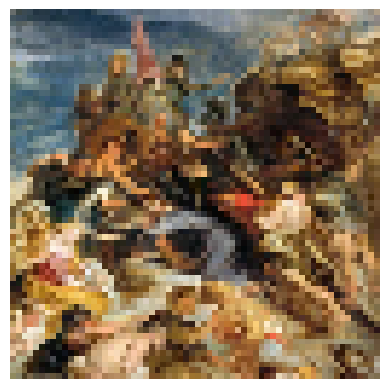

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt

def get_dataloader_tf(batch_size, image_size, data_dir):
    def preprocess_image(image, label):
        image = tf.image.resize(image, [image_size, image_size])
        image = tf.cast(image, tf.float32)
        image = (image - 127.5) / 127.5
        return image, label

    data = tf.keras.preprocessing.image_dataset_from_directory(
        data_dir,
        label_mode='int',
        image_size=(image_size, image_size),
        batch_size=batch_size,
        
    )


    data = data.map(preprocess_image).prefetch(tf.data.experimental.AUTOTUNE)

    return data

def tensor_imshow(image):
    plt.imshow((image.numpy() * 127.5 + 127.5).astype("uint8"))
    plt.axis("off")
    plt.show()

# Testing the dataloader
image_root = 'resized'

batch_size, image_size = 5, 64
train_loader = get_dataloader_tf(batch_size, image_size, image_root)
dataiter = iter(train_loader)

img, _ = next(dataiter)
sample_img = img[-1]
tensor_imshow(sample_img)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

class Generator(tf.keras.Model):
    def __init__(self, z_dim=10, in_chan=3, hidden_dim=64, input_type='noise'):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.in_chan = in_chan
        self.hidden_dim = hidden_dim
        self.input_type = input_type

        if input_type == 'noise':
            self.initial_block = tf.keras.Sequential([
                tf.keras.layers.Dense(4 * 4 * 512, use_bias=False, input_shape=(z_dim,)),
                tf.keras.layers.BatchNormalization(),
                tf.keras.layers.LeakyReLU(),
                tf.keras.layers.Reshape((4, 4, 512)),
            ])
        else:
            self.initial_block = self.make_initial_block(in_chan)
        
        self.generator = tf.keras.Sequential([
            tf.keras.layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(32, (4, 4), strides=(2, 2), padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(in_chan, (4, 4), strides=(2, 2), padding='same', use_bias=False, activation='tanh')
        ])

    def make_gen_block(self, in_channels, op_channels, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = []
        layers.append(tf.keras.layers.Conv2DTranspose(op_channels, kernel_size, strides=stride, padding=padding, use_bias=False))
        

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            layers.append(tf.keras.layers.Activation('tanh'))

        return tf.keras.Sequential(layers)

    def make_initial_block(self, in_chan):
        layers = [
            tf.keras.layers.Conv2D(512, (4, 4), strides=(2, 2), padding='same', use_bias=False, input_shape=(None, None, in_chan)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
        ]
        return tf.keras.Sequential(layers)

    def call(self, input_tensor):
        x = self.initial_block(input_tensor)
        return self.generator(x)
    def get_noise(self, n_samples, z_dim):
        return tf.random.normal([n_samples, z_dim])


class Discriminator(tf.keras.Model):
    def __init__(self, im_chan=3, conv_dim=64, image_size=64):
        super(Discriminator, self).__init__()
        self.image_size = image_size
        self.conv_dim = conv_dim

        self.disc_cnn = tf.keras.Sequential([
            self.make_disc_block(3, 32),
            self.make_disc_block(32, 64),
            self.make_disc_block(64, 128),
            self.make_disc_block(128, 256),
            self.make_disc_block(256, 512),
            self.make_disc_block(512, 1, padding=0, final_layer=True),
        ])

    def make_disc_block(self, in_chan, op_chan, kernel_size=4, stride=2, padding=1, final_layer=False):
        layers = [
            tf.keras.layers.Conv2D(op_chan, kernel_size, strides=stride, padding='same', use_bias=False)
        ]

        if not final_layer:
            layers.append(tf.keras.layers.BatchNormalization())
            layers.append(tf.keras.layers.LeakyReLU(0.2))
        else:
            # Add a GlobalAveragePooling2D layer before the final layer to ensure output shape is (batch_size, 1)
            layers.append(tf.keras.layers.GlobalAveragePooling2D())

        return tf.keras.Sequential(layers)

    def call(self, image):
        pred = self.disc_cnn(image)
        return pred



In [ ]:
device = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
print("Device is", device)
z_dim = 150
beta_1 = 0.5
beta_2 = 0.999

n_epochs = 20
lr = 0.0002
lr_g = 0.0004
batch_size = 25

image_size = 128

EPOCHS = 20

Device is GPU


In [ ]:
from tensorflow.keras import mixed_precision
policy = mixed_precision.Policy('mixed_float16')
mixed_precision.set_global_policy(policy)


In [ ]:
# Generator and Discriminator classes remain unchanged
image_root_B = 'landscapu/'
image_root_A = 'resized/'
# Create two generator instances and two discriminator instances
gen_A_to_B = Generator(z_dim, in_chan=3, hidden_dim=64, input_type='image')
gen_B_to_A = Generator(z_dim, in_chan=3, hidden_dim=64, input_type='image')

disc_A = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)
disc_B = Discriminator(im_chan=3, conv_dim=64, image_size=image_size)

# Initialize the optimizers
g_optimizer = tf.keras.optimizers.RMSprop(learning_rate=lr_g)
d_optimizer_A = tf.keras.optimizers.RMSprop(learning_rate=lr)
d_optimizer_B = tf.keras.optimizers.RMSprop(learning_rate=lr)

# Dataloaders for domain A and domain B
train_dataset_A = get_dataloader_tf(batch_size, image_size, image_root_A)
train_dataset_B = get_dataloader_tf(batch_size, image_size, image_root_B)

# CycleGAN training function
def train_cycle_gan(disc_A, disc_B, gen_A_to_B, gen_B_to_A, dataloader_A, dataloader_B, d_optimizer_A, d_optimizer_B, g_optimizer, z_dim, n_epochs, device, lambda_cycle=10, lambda_identity=5, print_every=5):
    for epoch in range(n_epochs):
        for real_A, real_B in zip(dataloader_A, dataloader_B):
            real_A, real_B = real_A[0], real_B[0]

            with tf.GradientTape(persistent=True) as tape:
                fake_B = gen_A_to_B(real_A)
                cycle_A = gen_B_to_A(fake_B)

                fake_A = gen_B_to_A(real_B)
                cycle_B = gen_A_to_B(fake_A)

                identity_A = gen_B_to_A(real_A)
                identity_B = gen_A_to_B(real_B)

                disc_real_A = disc_A(real_A)
                disc_real_B = disc_B(real_B)

                disc_fake_A = disc_A(fake_A)
                disc_fake_B = disc_B(fake_B)

                # LSGAN losses
                g_loss_A_to_B = tf.reduce_mean(tf.square(disc_fake_B - 1.0))
                g_loss_B_to_A = tf.reduce_mean(tf.square(disc_fake_A - 1.0))

                d_loss_A = 0.5 * (tf.reduce_mean(tf.square(disc_real_A - 1.0)) + tf.reduce_mean(tf.square(disc_fake_A)))
                d_loss_B = 0.5 * (tf.reduce_mean(tf.square(disc_real_B - 1.0)) + tf.reduce_mean(tf.square(disc_fake_B)))

                cycle_loss_A = tf.reduce_mean(tf.abs(real_A - cycle_A))
                cycle_loss_B = tf.reduce_mean(tf.abs(real_B - cycle_B))

                identity_loss_A = tf.reduce_mean(tf.abs(real_A - identity_A))
                identity_loss_B = tf.reduce_mean(tf.abs(real_B - identity_B))

                total_cycle_loss = cycle_loss_A + cycle_loss_B
                total_identity_loss = identity_loss_A + identity_loss_B
                total_g_loss = g_loss_A_to_B + g_loss_B_to_A + lambda_cycle * total_cycle_loss + lambda_identity * total_identity_loss

            # Update the generators
            gen_gradients = tape.gradient(total_g_loss, gen_A_to_B.trainable_variables + gen_B_to_A.trainable_variables)
            g_optimizer.apply_gradients(zip(gen_gradients, gen_A_to_B.trainable_variables + gen_B_to_A.trainable_variables))

            # Update the discriminators
            disc_A_gradients = tape.gradient(d_loss_A, disc_A.trainable_variables)
            disc_B_gradients = tape.gradient(d_loss_B, disc_B.trainable_variables)

            d_optimizer_A.apply_gradients(zip(disc_A_gradients, disc_A.trainable_variables))
            d_optimizer_B.apply_gradients(zip(disc_B_gradients, disc_B.trainable_variables))

        # Print the losses and generate images
        if (epoch + 1) % print_every == 0:
            print(f"Epoch [{epoch + 1}/{n_epochs}] | d_loss_A: {d_loss_A:.4f} | d_loss_B: {d_loss_B:.4f} | g_loss: {total_g_loss:.4f}")

            # Generate images
            with tf.device(device):
                gen_images_A_to_B = gen_A_to_B(real_A[:5])
                gen_images_B_to_A = gen_B_to_A(real_B[:5])


            print("Generated images from domain A to domain B:")
            print_tensor_images(gen_images_A_to_B[:5])

            print("Generated images from domain B to domain A:")
            print_tensor_images(gen_images_B_to_A[:5])

# Train the CycleGAN model
train_cycle_gan(disc_A, disc_B, gen_A_to_B, gen_B_to_A, train_dataset_A, train_dataset_B, d_optimizer_A, d_optimizer_B, g_optimizer, z_dim, EPOCHS, device)



Found 8683 files belonging to 1 classes.
Found 4319 files belonging to 1 classes.


In [ ]:
z_dim

150

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, initializers

class WSConv2D(tf.keras.layers.Layer):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding="same"):
        super(WSConv2D, self).__init__()

        self.conv = tf.keras.layers.Conv2D(
            filters=out_channels,
            kernel_size=kernel_size,
            strides=stride,
            padding=padding,
            use_bias=False,
            kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=1.0),
        )
        self.scale = tf.Variable(
            initial_value=tf.ones((out_channels,)) / tf.math.sqrt(float(in_channels)),
            trainable=True,
            dtype=tf.float32,
        )
        self.epsilon = 1e-8

    def call(self, x):
        # Weight scaling
        if self.conv.weights:
            normalized_weights = tf.nn.l2_normalize(self.conv.weights[0], axis=[0, 1, 2]) * self.scale
            self.conv.set_weights([normalized_weights])

        # Forward pass
        return self.conv(x)




In [ ]:
def test_wsconv2d():
    batch_size = 4
    input_height, input_width, input_channels = 32, 32, 3
    output_channels = 64
    kernel_size = 3
    stride = 1

    # Create a random input tensor with the shape (batch_size, input_height, input_width, input_channels)
    input_tensor = tf.random.normal((batch_size, input_height, input_width, input_channels))

    # Create the WSConv2D layer
    wsconv2d = WSConv2D(input_channels, output_channels, kernel_size, stride)

    # Pass the input tensor through the layer
    output_tensor = wsconv2d(input_tensor)

    # Check if the output tensor has the expected shape
    expected_shape = (batch_size, input_height, input_width, output_channels)
    assert output_tensor.shape == expected_shape, f"Expected output shape {expected_shape}, but got {output_tensor.shape}"

    print("Test passed. Output tensor shape:", output_tensor.shape)

# Run the test
test_wsconv2d()


Test passed. Output tensor shape: (4, 32, 32, 64)


In [ ]:
class PixelNorm(Layer):
    def __init__(self, epsilon=1e-8):
        super(PixelNorm, self).__init__()
        self.epsilon = epsilon

    def call(self, x):
        return x / tf.sqrt(tf.reduce_mean(x ** 2, axis=-1, keepdims=True) + self.epsilon)


class ConvBlock(Model):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, use_pixelnorm=True):
        super(ConvBlock, self).__init__()
        self.use_pn = use_pixelnorm
        self.conv1 = WSConv2D(in_channels, out_channels, kernel_size=kernel_size, stride=stride)
        self.conv2 = WSConv2D(out_channels, out_channels, kernel_size=kernel_size, stride=stride)
        self.leaky = tf.keras.layers.LeakyReLU(0.2)
        self.pn = PixelNorm()

    def call(self, x):
        x = self.leaky(self.conv1(x))
        x = self.pn(x) if self.use_pn else x
        x = self.leaky(self.conv2(x))
        x = self.pn(x) if self.use_pn else x
        return x


This code defines a ProGAN (Progressive Growing of GANs) implementation in PyTorch. It consists of a generator and a discriminator, both built with progressively growing capabilities. The main idea of ProGAN is to train the GAN on low-resolution images first and then progressively increase the resolution during training. This helps stabilize the training process and allows for the generation of higher-quality images.

Here's a breakdown of the main components of the code:

factors: A list containing factors for controlling the number of channels in each layer of the generator and discriminator as the image size increases.

WSConv2d: A custom weight-scaled convolutional layer (Equalized Learning Rate) that scales the input instead of the weights, which has the same effect.

PixelNorm: A custom normalization layer that normalizes each pixel in the feature maps using the mean pixel values across channels.

ConvBlock: A custom convolutional block that consists of two WSConv2d layers with an optional PixelNorm layer, followed by a LeakyReLU activation function.

Generator: The generator class that progressively grows its layers as the image size increases. It consists of an initial block for generating a 4x4 image, a list of progressive blocks for generating larger images, and a list of RGB layers for converting the feature maps to RGB images.

Discriminator: The discriminator class, which is the mirror image of the generator. It progressively downsamples the input images and consists of a list of progressive blocks and RGB layers. It also includes a minibatch standard deviation layer to provide information about the variation in the batch/image.

if __name__ == "__main__": A test loop that checks if the generator and discriminator work correctly for various image sizes (4, 8, 16, 32, 64, 128, 256, 512, 1024) by ensuring that the output shapes are correct.

Overall, this code provides a complete implementation of ProGAN using PyTorch, including custom layers and a modular design that allows for easy modification and experimentation.

In [ ]:
def test_pixelnorm():
    x = tf.random.normal((4, 32, 32, 3))
    pixel_norm = PixelNorm()
    output = pixel_norm(x)

    print("Input shape:", x.shape)
    print("Output shape:", output.shape)

test_pixelnorm()


Input shape: (4, 32, 32, 3)
Output shape: (4, 32, 32, 3)


In [ ]:
def test_convblock():
    x = tf.random.normal((4, 32, 32, 3))
    in_channels = 3
    out_channels = 64
    conv_block = ConvBlock(in_channels, out_channels)
    output = conv_block(x)

    print("Input shape:", x.shape)
    print("Output shape:", output.shape)

test_convblock()


Input shape: (4, 32, 32, 3)
Output shape: (4, 32, 32, 64)


In [ ]:
class Generator(Model):
    def __init__(self, z_dim, in_channels, img_channels=3):
        super(Generator, self).__init__()

        self.initial = tf.keras.Sequential([
            PixelNorm(),
            tf.keras.layers.Conv2DTranspose(z_dim, in_channels, 4, 1, "valid"),
            tf.keras.layers.LeakyReLU(0.2),
            WSConv2D(in_channels, in_channels, kernel_size=3, stride=1, padding="same"),
            tf.keras.layers.LeakyReLU(0.2),
            PixelNorm(),
        ])

        self.initial_rgb = WSConv2D(in_channels, img_channels, kernel_size=1, stride=1, padding="valid")
        self.prog_blocks, self.rgb_layers = (
            [ConvBlock(int(in_channels * factors[i]), int(in_channels * factors[i + 1])) for i in range(len(factors) - 1)],
            [self.initial_rgb] + [WSConv2D(int(in_channels * factors[i + 1]), img_channels, kernel_size=1, stride=1, padding="valid") for i in range(len(factors) - 1)],
        )

    def fade_in(self, alpha, upscaled, generated):
        return tf.tanh(alpha * generated + (1 - alpha) * upscaled)

    def call(self, x, alpha, steps):
        out = self.initial(x)

        if steps == 0:
            return self.initial_rgb(out)

        for step in range(steps):
            upscaled = tf.image.resize(out, size=tf.shape(out)[1:3] * 2, method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
            out = self.prog_blocks[step](upscaled)

        final_upscaled = self.rgb_layers[steps - 1](upscaled)
        final_out = self.rgb_layers[steps](out)
        return self.fade_in(alpha, final_upscaled, final_out)

class Discriminator(Model):
    def __init__(self, in_channels, img_channels=3):
        super(Discriminator, self).__init__()
        self.prog_blocks, self.rgb_layers = (
            [ConvBlock(int(in_channels * factors[i]), int(in_channels * factors[i - 1]), use_pixelnorm=False) for i in range(len(factors) - 1, 0, -1)],
            [WSConv2D(img_channels, int(in_channels * factors[i]), kernel_size=1, stride=1, padding="valid") for i in range(len(factors) - 1, -1, -1)],
        )

        self.leaky = tf.keras.layers.LeakyReLU(0.2)
        self.avg_pool = tf.keras.layers.AveragePooling2D(pool_size=2, strides=2)

        self.final_block = tf.keras.Sequential([
            WSConv2D(in_channels + 1, in_channels, kernel_size=3, padding="same"),
            tf.keras.layers.LeakyReLU(0.2),
            WSConv2D(in_channels, in_channels, kernel_size=4, padding="valid", stride=1),
            tf.keras.layers.LeakyReLU(0.2),
            WSConv2D(in_channels, 1, kernel_size=1, padding="valid", stride=1),
        ])
    def fade_in(self, alpha, downscaled, out):
        return alpha * out + (1 - alpha) * downscaled

    def minibatch_std(self, x):
        batch_statistics = tf.math.reduce_std(x, axis=0)
        batch_statistics = tf.math.reduce_mean(batch_statistics)
        batch_statistics = tf.tile(batch_statistics[tf.newaxis, tf.newaxis, tf.newaxis], [tf.shape(x)[0], 1, tf.shape(x)[2], tf.shape(x)[3]])
        return tf.concat([x, batch_statistics], axis=1)

    def call(self, x, alpha, steps):
        cur_step = len(self.prog_blocks) - steps
        out = self.leaky(self.rgb_layers[cur_step](x))

        if steps == 0:
            out = self.minibatch_std(out)
            return self.final_block(out)

        downscaled = self.leaky(self.rgb_layers[cur_step + 1](self.avg_pool(x)))
        out = self.avg_pool(self.prog_blocks[cur_step](out))
        out = self.fade_in(alpha, downscaled, out)

        for step in range(cur_step + 1, len(self.prog_blocks)):
            out = self.prog_blocks[step](out)
            out = self.avg_pool(out)

        out = self.minibatch_std(out)
        return self.final_block(out)


In [ ]:
import cv2
import tensorflow as tf
from math import log2

START_TRAIN_AT_IMG_SIZE = 128
DATASET = 'resized'
CHECKPOINT_GEN = "generator.h5"
CHECKPOINT_CRITIC = "critic.h5"
DEVICE = "GPU" if tf.config.list_physical_devices('GPU') else "CPU"
SAVE_MODEL = True
LOAD_MODEL = False
LEARNING_RATE = 1e-3
BATCH_SIZES = [32, 32, 32, 16, 16, 16, 16, 8, 4]
CHANNELS_IMG = 3
Z_DIM = 256  # should be 512 in original paper
IN_CHANNELS = 256  # should be 512 in original paper
CRITIC_ITERATIONS = 1
LAMBDA_GP = 10
PROGRESSIVE_EPOCHS = [30] * len(BATCH_SIZES)
FIXED_NOISE = tf.random.normal([8, 1, 1, Z_DIM])
NUM_WORKERS = 4


In [ ]:
def plot_to_tensorboard(
    writer, loss_critic, loss_gen, real, fake, tensorboard_step
):
    writer.add_scalar("Loss Critic", loss_critic, global_step=tensorboard_step)

    with torch.no_grad():
        # take out (up to) 8 examples to plot
        img_grid_real = torchvision.utils.make_grid(real[:8], normalize=True)
        img_grid_fake = torchvision.utils.make_grid(fake[:8], normalize=True)
        writer.add_image("Real", img_grid_real, global_step=tensorboard_step)
        writer.add_image("Fake", img_grid_fake, global_step=tensorboard_step)


def gradient_penalty(critic, real, fake, alpha, train_step, device="cpu"):
    BATCH_SIZE, C, H, W = real.shape
    beta = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
    interpolated_images = real * beta + fake.detach() * (1 - beta)
    interpolated_images.requires_grad_(True)

    # Calculate critic scores
    mixed_scores = critic(interpolated_images, alpha, train_step)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty



In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

def make_grid(images, nrow=8, padding=2, normalize=True):
    img_grid = tf.transpose(images, perm=[0, 2, 3, 1])
    img_grid = np.array(img_grid)
    if normalize:
        img_grid = (img_grid + 1) / 2
    
    num_images, height, width, channels = img_grid.shape
    num_cols = num_images // nrow
    grid = np.zeros((height * num_cols + padding * (num_cols - 1), nrow * width + padding * (nrow - 1), channels))
    
    for i in range(num_cols):
        for j in range(nrow):
            idx = i * nrow + j
            if idx >= num_images:
                break
            grid[i * (height + padding): i * (height + padding) + height, j * (width + padding): j * (width + padding) + width] = img_grid[idx]

    return grid

import tensorflow as tf
import numpy as np

def plot_to_tensorboard(
    writer, loss_critic, loss_gen, real, fake, tensorboard_step
):
    with writer.as_default():
        tf.summary.scalar("Loss Critic", loss_critic, step=tensorboard_step)
        
        with tf.device("CPU:0"):
            # take out (up to) 8 examples to plot
            img_grid_real = make_grid(real[:8], normalize=True)
            img_grid_fake = make_grid(fake[:8], normalize=True)
            tf.summary.image("Real", img_grid_real[None, ...], step=tensorboard_step)
            tf.summary.image("Fake", img_grid_fake[None, ...], step=tensorboard_step)
        writer.flush()


In [ ]:
from tensorflow.summary import create_file_writer

# Create TensorBoard writer
log_dir = "logs"
writer = create_file_writer(log_dir)

# Generate some fake data
loss_critic = 0.5
loss_gen = 0.6
real = tf.random.normal((16, 3, 32, 32))
fake = tf.random.normal((16, 3, 32, 32))
tensorboard_step = 1

# Run the test
plot_to_tensorboard(writer, loss_critic, loss_gen, real, fake, tensorboard_step)


In [ ]:
import tensorflow as tf

@tf.function
def gradient_penalty(critic, real, fake, alpha, train_step, device="cpu"):
    BATCH_SIZE, H, W, C = real.shape
    beta = tf.random.uniform((BATCH_SIZE, 1, 1, 1), minval=0, maxval=1)
    beta = tf.repeat(beta, C * H * W, axis=-1)
    beta = tf.reshape(beta, (BATCH_SIZE, H, W, C))
    
    interpolated_images = real * beta + fake * (1 - beta)
    with tf.GradientTape() as tape:
        tape.watch(interpolated_images)
        mixed_scores = critic(interpolated_images, alpha, train_step)

    gradient = tape.gradient(mixed_scores, interpolated_images)
    gradient = tf.reshape(gradient, (BATCH_SIZE, -1))
    gradient_norm = tf.norm(gradient, ord=2, axis=1)
    gradient_penalty = tf.reduce_mean(tf.square(gradient_norm - 1))
    return gradient_penalty


In [ ]:
import os
import random
import numpy as np
import tensorflow as tf

def save_checkpoint(model, optimizer, filename="my_checkpoint.tf"):
    print("=> Saving checkpoint")
    model.save_weights(filename)
    optimizer_weights = tf.Variable(optimizer.get_weights())
    tf.saved_model.save(optimizer_weights, filename + '_optimizer')


def load_checkpoint(checkpoint_file, model, optimizer, lr):
    print("=> Loading checkpoint")
    model.load_weights(checkpoint_file)
    optimizer_weights = tf.saved_model.load(checkpoint_file + '_optimizer')
    optimizer.set_weights(optimizer_weights.numpy())

    # Update the learning rate
    optimizer.lr.assign(lr)


def seed_everything(seed=42):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)


def generate_examples(gen, steps, truncation=0.7, n=100):
    gen.trainable = False
    alpha = 1.0
    for i in range(n):
        noise = np.random.normal(0, truncation, (1, 100, 1, 1)).astype(np.float32)
        img = gen(noise, alpha, steps)
        img = (img + 1) / 2
        img = tf.clip_by_value(img, 0, 1)
        img = tf.image.encode_png(tf.cast(img * 255, tf.uint8))
        tf.io.write_file(f"saved_examples/img_{i}.png", img)
    gen.trainable = True


In [ ]:
import tensorflow as tf
from tensorflow.keras import Model, layers
factors = [1, 1/2, 1/4, 1/8, 1/16, 1/32]

class SimpleGenerator(Model):
    def __init__(self, z_dim=100, in_channels=256, img_channels=3):
        super(SimpleGenerator, self).__init__()
        self.z_dim = z_dim
        self.in_channels = in_channels
        self.img_channels = img_channels

        self.initial = tf.keras.layers.Dense(4 * 4 * in_channels)
        self.blocks = [ConvBlock(in_channels, in_channels)]
        self.rgb_layers = [WSConv2D(in_channels, img_channels, kernel_size=1, stride=1, padding="same")]

    def call(self, x):
        x = self.initial(x)
        x = tf.reshape(x, (-1, self.in_channels, 4, 4))

        for block, rgb in zip(self.blocks, self.rgb_layers):
            x = block(x)
            x = rgb(x)

        return (tf.nn.tanh(x) + 1) / 2

class SimpleDiscriminator(Model):
    def __init__(self, in_channels, img_channels=3):
        super(SimpleDiscriminator, self).__init__()
        self.blocks = [ConvBlock(img_channels, in_channels)]
        self.rgb_layers = [WSConv2D(img_channels, in_channels, kernel_size=3, stride=1, padding="same")]

        self.final_block = ConvBlock(in_channels, in_channels, use_pixelnorm=False)
        self.flatten = layers.Flatten()
        self.final_dense = layers.Dense(1)

    def call(self, x):
        for block, rgb in zip(self.blocks, self.rgb_layers):
            x = rgb(x)
            x = block(x)

        x = self.final_block(x)
        x = self.flatten(x)
        x = self.final_dense(x)
        return x



# Instantiate the models
gen = SimpleGenerator()
disc = SimpleDiscriminator(IN_CHANNELS)

# Print the model summary



In [ ]:
import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_dataloader(batch_size=32, img_size=(64, 64), data_dir='resized/'):
    data_gen = ImageDataGenerator(rescale=1./255)
    data_iter = data_gen.flow_from_directory(
        data_dir,
        target_size=img_size,
        batch_size=batch_size,
        class_mode=None
    )
    return data_iter

# Usage example
batch_size = 32
img_size = (64, 64)
data_iter = create_dataloader(batch_size=batch_size, img_size=img_size, data_dir='resized/')

# Access a batch of data
batch_images = next(data_iter)
print(batch_images.shape)  # (32, 64, 64, 3)


Found 8683 images belonging to 1 classes.
(32, 64, 64, 3)


In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import save_img
import numpy as np

def train(gen, disc, data_iter, epochs=100, z_dim=100, alpha=1.0, steps=0, save_interval=10):
    gen_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    disc_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    
    for epoch in range(epochs):
        for real_images in data_iter:
            batch_size = real_images.shape[0]

            # Train the discriminator
            with tf.GradientTape() as disc_tape:
                z = tf.random.normal((batch_size, z_dim))
                fake_images = gen(z)

                real_logits = disc(real_images)
                fake_logits = disc(fake_images)

                gp = gradient_penalty(disc, real_images, fake_images, alpha, steps)
                disc_loss = tf.reduce_mean(fake_logits) - tf.reduce_mean(real_logits) + gp

            disc_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            disc_optimizer.apply_gradients(zip(disc_gradients, disc.trainable_variables))

            # Train the generator
            with tf.GradientTape() as gen_tape:
                z = tf.random.normal((batch_size, z_dim))
                fake_images = gen(z)
                fake_logits = disc(fake_images)
                gen_loss = -tf.reduce_mean(fake_logits)

            gen_gradients = gen_tape.gradient(gen_loss, gen.trainable_variables)
            gen_optimizer.apply_gradients(zip(gen_gradients, gen.trainable_variables))

        print(f"Epoch: {epoch+1}, Discriminator Loss: {disc_loss}, Generator Loss: {gen_loss}")

        # Save generated images periodically
        if (epoch + 1) % save_interval == 0:
            z = tf.random.normal((64, z_dim))
            fake_images = gen(z)
            fake_images = (fake_images + 1) * 127.5  # Convert to 0-255 range
            fake_images = np.array(fake_images, dtype=np.uint8)
            for i, img in enumerate(fake_images):
                save_img(f"generated_images/epoch_{epoch+1}_img_{i}.png", img)



In [ ]:
gen, disc = train(gen, disc, data_iter, epochs=100, z_dim=Z_DIM, alpha=1.0, steps=0)


ValueError: ignored